# Emotion Classification: Data Preparation

In this notebook, you'll:

- Upload up to 10 face images per emotion class.
- Organize them into folders by emotion.
- Split the dataset into training and testing sets.

**Emotions to capture:** `['happy', 'sad', 'angry', 'surprised', 'neutral']`

## 1. Setup and Imports
Install dependencies and import required modules:

In [3]:
#sample
#!pip install scikit-learn pandas
#import os
#from google.colab import files
#from sklearn.model_selection import train_test_split
#import pandas as pd

# Emotion classes
#emotions = ['happy', 'sad', 'angry', 'surprised', 'neutral']
#data_dir = 'data'

# Create data directories
#os.makedirs(data_dir, exist_ok=True)
#for emo in emotions:
#    os.makedirs(os.path.join(data_dir, emo), exist_ok=True)
#print("Setup complete. Data directories ready.")

In [4]:
!pip install opencv-python-headless scikit-image Pillow imageio[ffmpeg] moviepy ipywidgets matplotlib

In [5]:
from google.colab import files
import cv2, numpy as np
from PIL import Image
import imageio
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
%matplotlib inline


## 2. Upload Images per Emotion
For each emotion, upload up to 10 images. After selecting files, the dialog will close.

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:

import os

# Emotion classes
emotions = ['happy', 'sad', 'angry', 'surprised', 'neutral']
data_dir = 'data'

# Create data directories
os.makedirs(data_dir, exist_ok=True)
for emo in emotions:
    os.makedirs(os.path.join(data_dir, emo), exist_ok=True)
print("Setup complete. Data directories ready.")

Setup complete. Data directories ready.


In [8]:
# prompt: upload a folder of image from the google drive that only get the image from the folder of happy
# Load the Happy
import shutil

source_dir = '/content/drive/MyDrive/Computer Vision/LAB1/Happy'  # Replace with the actual path to your 'happy' folder in Drive
dest_dir = os.path.join(data_dir, 'happy')

# Check if the source directory exists
if os.path.exists(source_dir):
    # Get a list of files in the source directory
    image_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    # Copy each image file to the destination directory
    for image_file in image_files:
        source_path = os.path.join(source_dir, image_file)
        dest_path = os.path.join(dest_dir, image_file)
        shutil.copy2(source_path, dest_path)
        print(f"Copied: {image_file}")

    print(f"Finished copying images from '{source_dir}' to '{dest_dir}'.")
else:
    print(f"Error: Source directory '{source_dir}' not found.")

# Verify the copied files (optional)
print("\nFiles in destination directory:")
!ls {dest_dir}

Copied: 1_617fd1e2590c2.jpg
Copied: 1HEoLBLidT2u4mhJ0oiDgig.png
Copied: 05-12-21-happy-people.jpg
Copied: 2560px-Happy_People.jpg
Copied: 427394C200000578-0-image-a-24_1500384481554.jpg
Copied: dv2051009.jpg
Copied: web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg
Copied: riskshappypeopletakeh_1384254283.jpg
Copied: Happy-people-800x533.jpg
Copied: happy-people12.jpg
Finished copying images from '/content/drive/MyDrive/Computer Vision/LAB1/Happy' to 'data/happy'.

Files in destination directory:
05-12-21-happy-people.jpg
1_617fd1e2590c2.jpg
1HEoLBLidT2u4mhJ0oiDgig.png
2560px-Happy_People.jpg
427394C200000578-0-image-a-24_1500384481554.jpg
dv2051009.jpg
happy-people12.jpg
Happy-people-800x533.jpg
riskshappypeopletakeh_1384254283.jpg
web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg


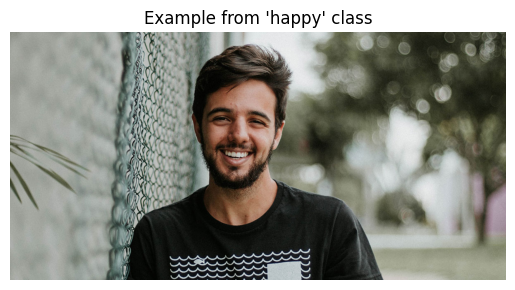

In [9]:
# prompt: display one image from the happy class

happy_images_dir = os.path.join(data_dir, 'happy')
if os.path.exists(happy_images_dir) and os.listdir(happy_images_dir):
  # List all files in the happy directory
  happy_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f))]

  # Select the first file (or any file you want)
  first_happy_image_path = os.path.join(happy_images_dir, happy_files[0])

  # Read the image using OpenCV
  img = cv2.imread(first_happy_image_path)

  # Convert the image from BGR to RGB (Matplotlib expects RGB)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Display the image
  plt.imshow(img_rgb)
  plt.title("Example from 'happy' class")
  plt.axis('off') # Hide axes
  plt.show()
else:
  print(f"No images found in the '{happy_images_dir}' directory.")


In [10]:
# prompt: upload a folder of image from the google drive that only get the image from the folder of happy
# Load the Angry
import shutil

source_dir = '/content/drive/MyDrive/Computer Vision/LAB1/Angry'  # Replace with the actual path to your 'happy' folder in Drive
dest_dir = os.path.join(data_dir, 'angry')

# Check if the source directory exists
if os.path.exists(source_dir):
    # Get a list of files in the source directory
    image_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    # Copy each image file to the destination directory
    for image_file in image_files:
        source_path = os.path.join(source_dir, image_file)
        dest_path = os.path.join(dest_dir, image_file)
        shutil.copy2(source_path, dest_path)
        print(f"Copied: {image_file}")

    print(f"Finished copying images from '{source_dir}' to '{dest_dir}'.")
else:
    print(f"Error: Source directory '{source_dir}' not found.")

# Verify the copied files (optional)
print("\nFiles in destination directory:")
!ls {dest_dir}

Copied: 68-688804_angry-person-png-images-angry-man-transparent-png.png
Copied: 118-1183761_angry-person-transparent-images-png-angry-man-png.png
Copied: 118-1183847_angry-person-png-picture.png
Copied: 439-4398363_angry-man-png-pictures-angry-person-png-transparent.png
Copied: 800px-Angry-2766265_960_720.jpg
Copied: Anger_Controlls_Him.jpg
Copied: anger_ruining_898.jpg
Copied: anger-18615_640.jpg
Copied: anger-can-kill-you-main.jpg
Copied: Angry-Customer.jpg
Finished copying images from '/content/drive/MyDrive/Computer Vision/LAB1/Angry' to 'data/angry'.

Files in destination directory:
118-1183761_angry-person-transparent-images-png-angry-man-png.png
118-1183847_angry-person-png-picture.png
439-4398363_angry-man-png-pictures-angry-person-png-transparent.png
68-688804_angry-person-png-images-angry-man-transparent-png.png
800px-Angry-2766265_960_720.jpg
anger-18615_640.jpg
anger-can-kill-you-main.jpg
Anger_Controlls_Him.jpg
anger_ruining_898.jpg
Angry-Customer.jpg


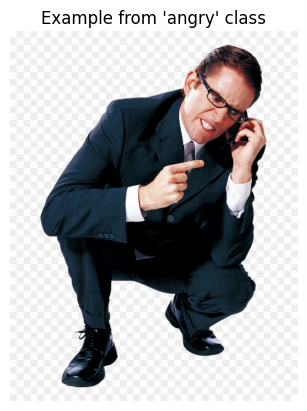

In [11]:
# prompt: display one image from the Angry class

happy_images_dir = os.path.join(data_dir, 'angry')
if os.path.exists(happy_images_dir) and os.listdir(happy_images_dir):
  # List all files in the happy directory
  happy_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f))]

  # Select the first file (or any file you want)
  first_happy_image_path = os.path.join(happy_images_dir, happy_files[0])

  # Read the image using OpenCV
  img = cv2.imread(first_happy_image_path)

  # Convert the image from BGR to RGB (Matplotlib expects RGB)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Display the image
  plt.imshow(img_rgb)
  plt.title("Example from 'angry' class")
  plt.axis('off') # Hide axes
  plt.show()
else:
  print(f"No images found in the '{happy_images_dir}' directory.")


In [12]:
# prompt: upload a folder of image from the google drive that only get the image from the folder of happy
# Load the neutral
import shutil

source_dir = '/content/drive/MyDrive/Computer Vision/LAB1/Neutral'  # Replace with the actual path to your 'happy' folder in Drive
dest_dir = os.path.join(data_dir, 'neutral')

# Check if the source directory exists
if os.path.exists(source_dir):
    # Get a list of files in the source directory
    image_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    # Copy each image file to the destination directory
    for image_file in image_files:
        source_path = os.path.join(source_dir, image_file)
        dest_path = os.path.join(dest_dir, image_file)
        shutil.copy2(source_path, dest_path)
        print(f"Copied: {image_file}")

    print(f"Finished copying images from '{source_dir}' to '{dest_dir}'.")
else:
    print(f"Error: Source directory '{source_dir}' not found.")

# Verify the copied files (optional)
print("\nFiles in destination directory:")
!ls {dest_dir}

Copied: Neutral.jpg
Copied: Neutral (1).jpg
Copied: Neutral (2).jpg
Copied: Neutral (3).jpg
Copied: Neutral (4).jpg
Copied: Neutral (5).jpg
Copied: Neutral (6).jpg
Copied: Neutral (7).jpg
Copied: Neutral (8).jpg
Copied: Neutral (9).jpg
Finished copying images from '/content/drive/MyDrive/Computer Vision/LAB1/Neutral' to 'data/neutral'.

Files in destination directory:
'Neutral (1).jpg'  'Neutral (4).jpg'  'Neutral (7).jpg'   Neutral.jpg
'Neutral (2).jpg'  'Neutral (5).jpg'  'Neutral (8).jpg'
'Neutral (3).jpg'  'Neutral (6).jpg'  'Neutral (9).jpg'


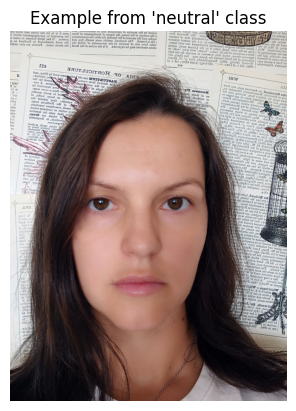

In [13]:
# prompt: display one image from the neutral class

happy_images_dir = os.path.join(data_dir, 'neutral')
if os.path.exists(happy_images_dir) and os.listdir(happy_images_dir):
  # List all files in the happy directory
  happy_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f))]

  # Select the first file (or any file you want)
  first_happy_image_path = os.path.join(happy_images_dir, happy_files[0])

  # Read the image using OpenCV
  img = cv2.imread(first_happy_image_path)

  # Convert the image from BGR to RGB (Matplotlib expects RGB)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Display the image
  plt.imshow(img_rgb)
  plt.title("Example from 'neutral' class")
  plt.axis('off') # Hide axes
  plt.show()
else:
  print(f"No images found in the '{happy_images_dir}' directory.")


In [14]:
# prompt: upload a folder of image from the google drive that only get the image from the folder of happy
# Load the Sad
import shutil

source_dir = '/content/drive/MyDrive/Computer Vision/LAB1/Sad'  # Replace with the actual path to your 'happy' folder in Drive
dest_dir = os.path.join(data_dir, 'sad')

# Check if the source directory exists
if os.path.exists(source_dir):
    # Get a list of files in the source directory
    image_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    # Copy each image file to the destination directory
    for image_file in image_files:
        source_path = os.path.join(source_dir, image_file)
        dest_path = os.path.join(dest_dir, image_file)
        shutil.copy2(source_path, dest_path)
        print(f"Copied: {image_file}")

    print(f"Finished copying images from '{source_dir}' to '{dest_dir}'.")
else:
    print(f"Error: Source directory '{source_dir}' not found.")

# Verify the copied files (optional)
print("\nFiles in destination directory:")
!ls {dest_dir}

Copied: 0x0.jpg
Copied: 5acf9ed1146e711e008b46d7.jpg
Copied: 405-4050267_sad-people-png-sad-person-transparent-background-png.png
Copied: 640px-Crying-girl.jpg
Copied: 766x415_Depression_vs_Sadness-1-732x415.jpg
Copied: 20201112-Alexithymia-844.jpg
Copied: 39843138-sad-man.jpg
Copied: african-american-depressive-sad-broken-260nw-475790911.jpg
Copied: depositphotos_11207956-stock-photo-thoughtful-man-in-the-living.jpg
Copied: depositphotos_86851530-stock-photo-close-up-of-african-young.jpg
Finished copying images from '/content/drive/MyDrive/Computer Vision/LAB1/Sad' to 'data/sad'.

Files in destination directory:
0x0.jpg
20201112-Alexithymia-844.jpg
39843138-sad-man.jpg
405-4050267_sad-people-png-sad-person-transparent-background-png.png
5acf9ed1146e711e008b46d7.jpg
640px-Crying-girl.jpg
766x415_Depression_vs_Sadness-1-732x415.jpg
african-american-depressive-sad-broken-260nw-475790911.jpg
depositphotos_11207956-stock-photo-thoughtful-man-in-the-living.jpg
depositphotos_86851530-stock-p

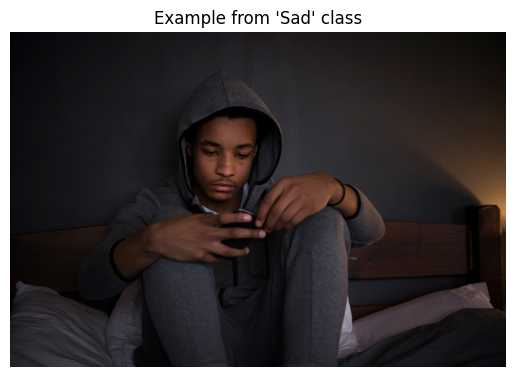

In [15]:
# prompt: display one image from the sad class

happy_images_dir = os.path.join(data_dir, 'sad')
if os.path.exists(happy_images_dir) and os.listdir(happy_images_dir):
  # List all files in the happy directory
  happy_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f))]

  # Select the first file (or any file you want)
  first_happy_image_path = os.path.join(happy_images_dir, happy_files[0])

  # Read the image using OpenCV
  img = cv2.imread(first_happy_image_path)

  # Convert the image from BGR to RGB (Matplotlib expects RGB)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Display the image
  plt.imshow(img_rgb)
  plt.title("Example from 'Sad' class")
  plt.axis('off') # Hide axes
  plt.show()
else:
  print(f"No images found in the '{happy_images_dir}' directory.")


In [16]:
# prompt: upload a folder of image from the google drive that only get the image from the folder of happy
# Load the Surprised
import shutil

source_dir = '/content/drive/MyDrive/Computer Vision/LAB1/Suprised'  # Replace with the actual path to your 'happy' folder in Drive
dest_dir = os.path.join(data_dir, 'surprised')

# Check if the source directory exists
if os.path.exists(source_dir):
    # Get a list of files in the source directory
    image_files = [f for f in os.listdir(source_dir) if os.path.isfile(os.path.join(source_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    # Copy each image file to the destination directory
    for image_file in image_files:
        source_path = os.path.join(source_dir, image_file)
        dest_path = os.path.join(dest_dir, image_file)
        shutil.copy2(source_path, dest_path)
        print(f"Copied: {image_file}")

    print(f"Finished copying images from '{source_dir}' to '{dest_dir}'.")
else:
    print(f"Error: Source directory '{source_dir}' not found.")

# Verify the copied files (optional)
print("\nFiles in destination directory:")
!ls {dest_dir}

Copied: Surprised.jpg
Copied: Surprised (1).jpg
Copied: Surprised (2).jpg
Copied: Surprised (3).jpg
Copied: Surprised (4).jpg
Copied: Surprised (5).jpg
Copied: Surprised (6).jpg
Copied: Surprised (7).jpg
Copied: Surprised (8).jpg
Copied: Surprised (9).jpg
Finished copying images from '/content/drive/MyDrive/Computer Vision/LAB1/Suprised' to 'data/surprised'.

Files in destination directory:
'Surprised (1).jpg'  'Surprised (4).jpg'  'Surprised (7).jpg'   Surprised.jpg
'Surprised (2).jpg'  'Surprised (5).jpg'  'Surprised (8).jpg'
'Surprised (3).jpg'  'Surprised (6).jpg'  'Surprised (9).jpg'


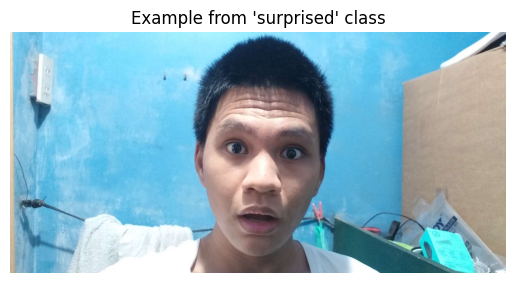

In [17]:
# prompt: display one image from the Surprised class

happy_images_dir = os.path.join(data_dir, 'surprised')
if os.path.exists(happy_images_dir) and os.listdir(happy_images_dir):
  # List all files in the happy directory
  happy_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f))]

  # Select the first file (or any file you want)
  first_happy_image_path = os.path.join(happy_images_dir, happy_files[3])

  # Read the image using OpenCV
  img = cv2.imread(first_happy_image_path)

  # Convert the image from BGR to RGB (Matplotlib expects RGB)
  img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

  # Display the image
  plt.imshow(img_rgb)
  plt.title("Example from 'surprised' class")
  plt.axis('off') # Hide axes
  plt.show()
else:
  print(f"No images found in the '{happy_images_dir}' directory.")


# **Image Preprocessing**

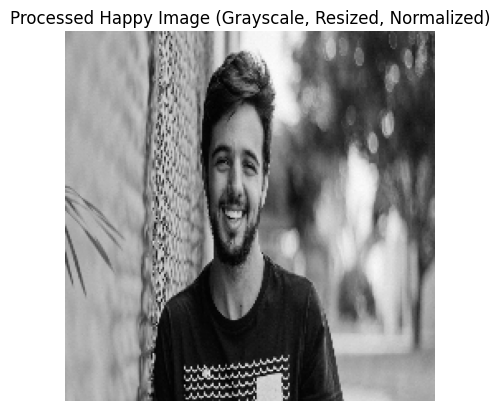

Original shape: (600, 1200, 3)
Processed shape: (224, 224)
Data type after normalization: float32


In [18]:
# prompt: Convert to grayscale, resize to 224×224, normalize pixel values just for the happy class an show me one example after the processing

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'happy')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # 1. Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 2. Resize to 224x224
            resized_img = cv2.resize(gray_img, (224, 224))

            # 3. Normalize pixel values to [0, 1]
            # Convert to float32 to avoid issues with division
            normalized_img = resized_img.astype(np.float32) / 255.0

            # Display the processed image
            plt.imshow(normalized_img, cmap='gray')
            plt.title("Processed Happy Image (Grayscale, Resized, Normalized)")
            plt.axis('off')
            plt.show()

            print("Original shape:", img.shape)
            print("Processed shape:", normalized_img.shape)
            print("Data type after normalization:", normalized_img.dtype)

        else:
            print(f"Could not read the image file: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")

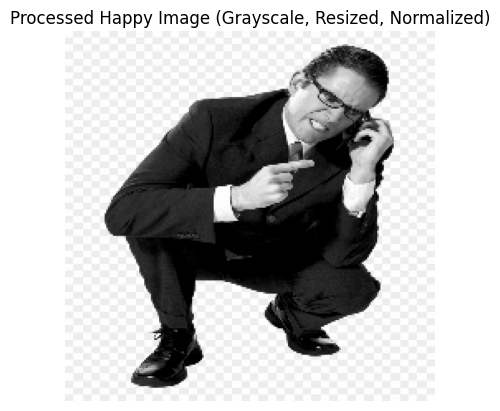

Original shape: (1080, 840, 3)
Processed shape: (224, 224)
Data type after normalization: float32


In [19]:
# prompt: Convert to grayscale, resize to 224×224, normalize pixel values just for the angry class an show me one example after the processing

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'angry')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # 1. Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 2. Resize to 224x224
            resized_img = cv2.resize(gray_img, (224, 224))

            # 3. Normalize pixel values to [0, 1]
            # Convert to float32 to avoid issues with division
            normalized_img = resized_img.astype(np.float32) / 255.0

            # Display the processed image
            plt.imshow(normalized_img, cmap='gray')
            plt.title("Processed Happy Image (Grayscale, Resized, Normalized)")
            plt.axis('off')
            plt.show()

            print("Original shape:", img.shape)
            print("Processed shape:", normalized_img.shape)
            print("Data type after normalization:", normalized_img.dtype)

        else:
            print(f"Could not read the image file: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")

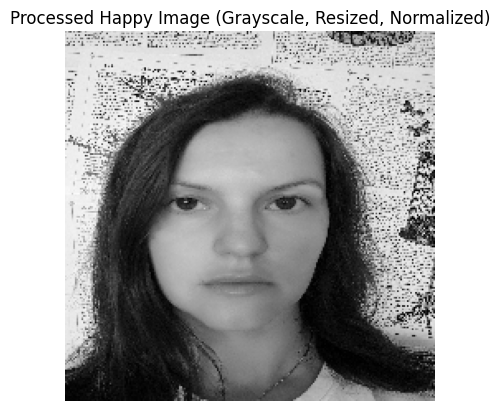

Original shape: (5184, 3880, 3)
Processed shape: (224, 224)
Data type after normalization: float32


In [20]:
# prompt: Convert to grayscale, resize to 224×224, normalize pixel values just for the neutral class an show me one example after the processing

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'neutral')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # 1. Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 2. Resize to 224x224
            resized_img = cv2.resize(gray_img, (224, 224))

            # 3. Normalize pixel values to [0, 1]
            # Convert to float32 to avoid issues with division
            normalized_img = resized_img.astype(np.float32) / 255.0

            # Display the processed image
            plt.imshow(normalized_img, cmap='gray')
            plt.title("Processed Happy Image (Grayscale, Resized, Normalized)")
            plt.axis('off')
            plt.show()

            print("Original shape:", img.shape)
            print("Processed shape:", normalized_img.shape)
            print("Data type after normalization:", normalized_img.dtype)

        else:
            print(f"Could not read the image file: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")

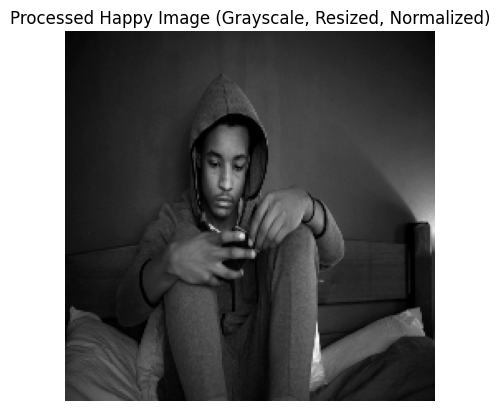

Original shape: (570, 844, 3)
Processed shape: (224, 224)
Data type after normalization: float32


In [21]:
# prompt: Convert to grayscale, resize to 224×224, normalize pixel values just for the sad class an show me one example after the processing

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'sad')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # 1. Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 2. Resize to 224x224
            resized_img = cv2.resize(gray_img, (224, 224))

            # 3. Normalize pixel values to [0, 1]
            # Convert to float32 to avoid issues with division
            normalized_img = resized_img.astype(np.float32) / 255.0

            # Display the processed image
            plt.imshow(normalized_img, cmap='gray')
            plt.title("Processed Happy Image (Grayscale, Resized, Normalized)")
            plt.axis('off')
            plt.show()

            print("Original shape:", img.shape)
            print("Processed shape:", normalized_img.shape)
            print("Data type after normalization:", normalized_img.dtype)

        else:
            print(f"Could not read the image file: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")

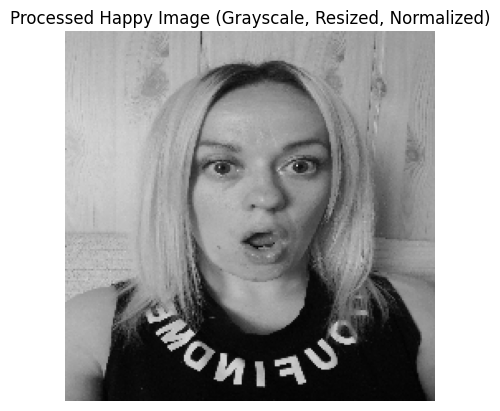

Original shape: (3408, 2556, 3)
Processed shape: (224, 224)
Data type after normalization: float32


In [22]:
# prompt: Convert to grayscale, resize to 224×224, normalize pixel values just for the surprised class an show me one example after the processing

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'surprised')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[4])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # 1. Convert to grayscale
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 2. Resize to 224x224
            resized_img = cv2.resize(gray_img, (224, 224))

            # 3. Normalize pixel values to [0, 1]
            # Convert to float32 to avoid issues with division
            normalized_img = resized_img.astype(np.float32) / 255.0

            # Display the processed image
            plt.imshow(normalized_img, cmap='gray')
            plt.title("Processed Happy Image (Grayscale, Resized, Normalized)")
            plt.axis('off')
            plt.show()

            print("Original shape:", img.shape)
            print("Processed shape:", normalized_img.shape)
            print("Data type after normalization:", normalized_img.dtype)

        else:
            print(f"Could not read the image file: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")

# **Classic CV Transforms**

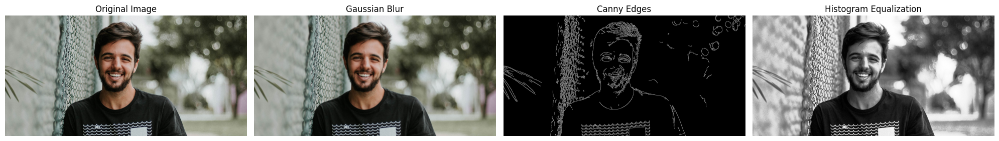

In [23]:
# prompt: Apply Gaussian blur, Canny edge detection, histogram equalization and Visualize before/after for one image from the happy class with the path

# Ensure the example_image_path and img are defined from the previous block
# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'happy')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # Convert the image to grayscale first for Canny and Histogram Equalization
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 1. Apply Gaussian Blur
            # Kernel size (needs to be odd) and standard deviation
            blurred_img = cv2.GaussianBlur(img, (5, 5), 0)

            # 2. Apply Canny Edge Detection
            # Need a grayscale image for Canny
            edges = cv2.Canny(gray_img, 100, 200) # Adjust thresholds as needed

            # 3. Apply Histogram Equalization
            # Need a grayscale image for histogram equalization
            equalized_img = cv2.equalizeHist(gray_img)

            # Visualize the original and transformed images
            fig, axes = plt.subplots(1, 4, figsize=(20, 5))

            # Original Image (convert BGR to RGB for matplotlib)
            axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            # Gaussian Blur
            axes[1].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB)) # Blur applied on BGR
            axes[1].set_title('Gaussian Blur')
            axes[1].axis('off')

            # Canny Edge Detection
            axes[2].imshow(edges, cmap='gray')
            axes[2].set_title('Canny Edges')
            axes[2].axis('off')

            # Histogram Equalization
            axes[3].imshow(equalized_img, cmap='gray')
            axes[3].set_title('Histogram Equalization')
            axes[3].axis('off')

            plt.tight_layout()
            plt.show()

        else:
            print(f"Could not read the image file for processing: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory for processing.")
else:
    # Add an indented block here to fix the IndentationError
    print(f"Directory not found: {happy_images_dir}")

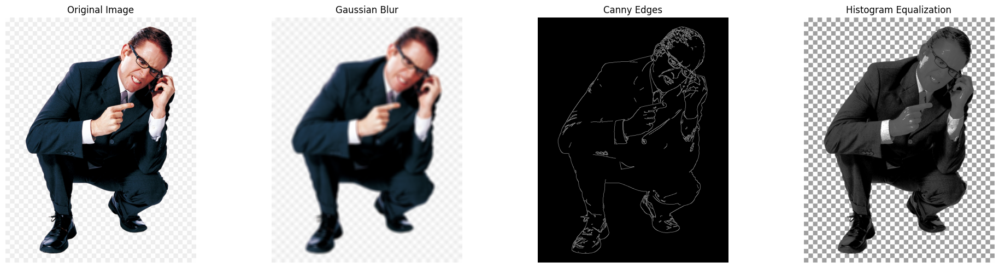

In [24]:
# prompt: Apply Gaussian blur, Canny edge detection, histogram equalization and Visualize before/after for one image from the angry class with the path

# Ensure the example_image_path and img are defined from the previous block
# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'angry')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # Convert the image to grayscale first for Canny and Histogram Equalization
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 1. Apply Gaussian Blur
            # Kernel size (needs to be odd) and standard deviation
            blurred_img = cv2.GaussianBlur(img, (15, 15), 15)

            # 2. Apply Canny Edge Detection
            # Need a grayscale image for Canny
            edges = cv2.Canny(gray_img, 100, 200) # Adjust thresholds as needed

            # 3. Apply Histogram Equalization
            # Need a grayscale image for histogram equalization
            equalized_img = cv2.equalizeHist(gray_img)

            # Visualize the original and transformed images
            fig, axes = plt.subplots(1, 4, figsize=(20, 5))

            # Original Image (convert BGR to RGB for matplotlib)
            axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            # Gaussian Blur
            axes[1].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB)) # Blur applied on BGR
            axes[1].set_title('Gaussian Blur')
            axes[1].axis('off')

            # Canny Edge Detection
            axes[2].imshow(edges, cmap='gray')
            axes[2].set_title('Canny Edges')
            axes[2].axis('off')

            # Histogram Equalization
            axes[3].imshow(equalized_img, cmap='gray')
            axes[3].set_title('Histogram Equalization')
            axes[3].axis('off')

            plt.tight_layout()
            plt.show()

        else:
            print(f"Could not read the image file for processing: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory for processing.")
else:
    # Add an indented block here to fix the IndentationError
    print(f"Directory not found: {happy_images_dir}")

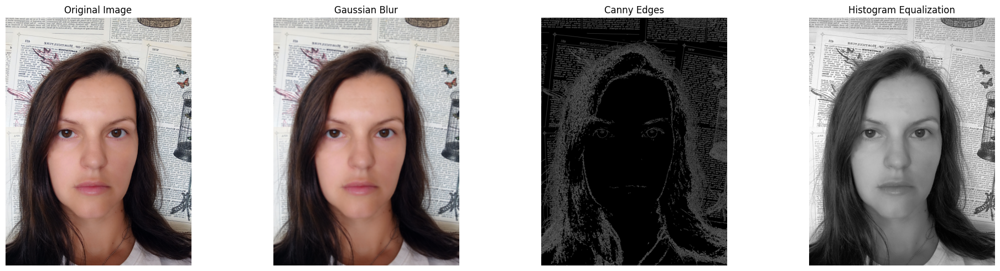

In [25]:
# prompt: Apply Gaussian blur, Canny edge detection, histogram equalization and Visualize before/after for one image from the neutral class with the path

# Ensure the example_image_path and img are defined from the previous block
# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'neutral')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # Convert the image to grayscale first for Canny and Histogram Equalization
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 1. Apply Gaussian Blur
            # Kernel size (needs to be odd) and standard deviation
            blurred_img = cv2.GaussianBlur(img, (23, 23), 23)

            # 2. Apply Canny Edge Detection
            # Need a grayscale image for Canny
            edges = cv2.Canny(gray_img, 30, 90) # Adjust thresholds as needed

            # 3. Apply Histogram Equalization
            # Need a grayscale image for histogram equalization
            equalized_img = cv2.equalizeHist(gray_img)

            # Visualize the original and transformed images
            fig, axes = plt.subplots(1, 4, figsize=(20, 5))

            # Original Image (convert BGR to RGB for matplotlib)
            axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            # Gaussian Blur
            axes[1].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB)) # Blur applied on BGR
            axes[1].set_title('Gaussian Blur')
            axes[1].axis('off')

            # Canny Edge Detection
            axes[2].imshow(edges, cmap='gray')
            axes[2].set_title('Canny Edges')
            axes[2].axis('off')

            # Histogram Equalization
            axes[3].imshow(equalized_img, cmap='gray')
            axes[3].set_title('Histogram Equalization')
            axes[3].axis('off')

            plt.tight_layout()
            plt.show()

        else:
            print(f"Could not read the image file for processing: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory for processing.")
else:
    # Add an indented block here to fix the IndentationError
    print(f"Directory not found: {happy_images_dir}")

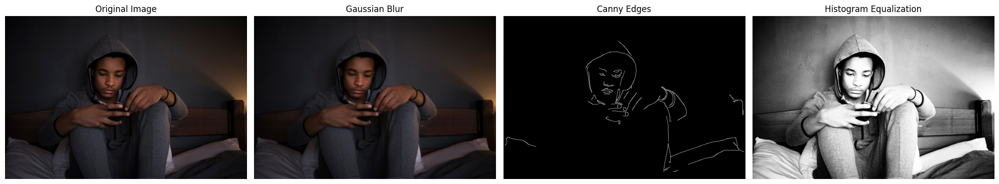

In [26]:
# prompt: Apply Gaussian blur, Canny edge detection, histogram equalization and Visualize before/after for one image from the sad class with the path

# Ensure the example_image_path and img are defined from the previous block
# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'sad')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # Convert the image to grayscale first for Canny and Histogram Equalization
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 1. Apply Gaussian Blur
            # Kernel size (needs to be odd) and standard deviation
            blurred_img = cv2.GaussianBlur(img, (5, 5), 0)

            # 2. Apply Canny Edge Detection
            # Need a grayscale image for Canny
            edges = cv2.Canny(gray_img, 100, 200) # Adjust thresholds as needed

            # 3. Apply Histogram Equalization
            # Need a grayscale image for histogram equalization
            equalized_img = cv2.equalizeHist(gray_img)

            # Visualize the original and transformed images
            fig, axes = plt.subplots(1, 4, figsize=(20, 5))

            # Original Image (convert BGR to RGB for matplotlib)
            axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            # Gaussian Blur
            axes[1].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB)) # Blur applied on BGR
            axes[1].set_title('Gaussian Blur')
            axes[1].axis('off')

            # Canny Edge Detection
            axes[2].imshow(edges, cmap='gray')
            axes[2].set_title('Canny Edges')
            axes[2].axis('off')

            # Histogram Equalization
            axes[3].imshow(equalized_img, cmap='gray')
            axes[3].set_title('Histogram Equalization')
            axes[3].axis('off')

            plt.tight_layout()
            plt.show()

        else:
            print(f"Could not read the image file for processing: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory for processing.")
else:
    # Add an indented block here to fix the IndentationError
    print(f"Directory not found: {happy_images_dir}")

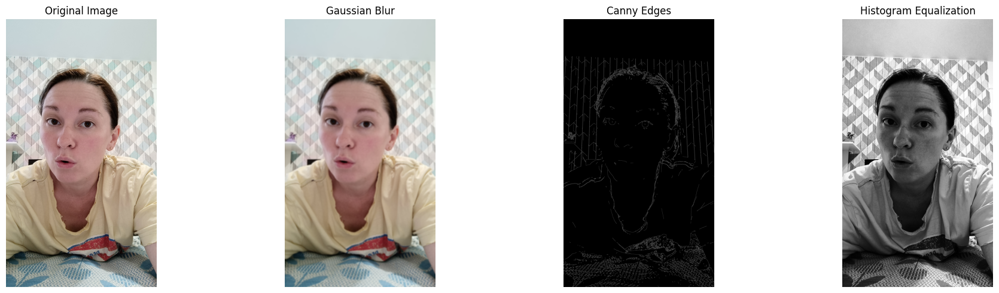

In [27]:
# prompt: Apply Gaussian blur, Canny edge detection, histogram equalization and Visualize before/after for one image from the surprised class with the path

# Ensure the example_image_path and img are defined from the previous block
# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'surprised')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if image_files:
        # Take the first image for processing (you can pick any)
        example_image_path = os.path.join(happy_images_dir, image_files[0])

        # Read the image using OpenCV
        img = cv2.imread(example_image_path)

        if img is not None:
            # Convert the image to grayscale first for Canny and Histogram Equalization
            gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

            # 1. Apply Gaussian Blur
            # Kernel size (needs to be odd) and standard deviation
            blurred_img = cv2.GaussianBlur(img, (25, 25), 25)

            # 2. Apply Canny Edge Detection
            # Need a grayscale image for Canny
            edges = cv2.Canny(gray_img, 100, 200) # Adjust thresholds as needed

            # 3. Apply Histogram Equalization
            # Need a grayscale image for histogram equalization
            equalized_img = cv2.equalizeHist(gray_img)

            # Visualize the original and transformed images
            fig, axes = plt.subplots(1, 4, figsize=(20, 5))

            # Original Image (convert BGR to RGB for matplotlib)
            axes[0].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            # Gaussian Blur
            axes[1].imshow(cv2.cvtColor(blurred_img, cv2.COLOR_BGR2RGB)) # Blur applied on BGR
            axes[1].set_title('Gaussian Blur')
            axes[1].axis('off')

            # Canny Edge Detection
            axes[2].imshow(edges, cmap='gray')
            axes[2].set_title('Canny Edges')
            axes[2].axis('off')

            # Histogram Equalization
            axes[3].imshow(equalized_img, cmap='gray')
            axes[3].set_title('Histogram Equalization')
            axes[3].axis('off')

            plt.tight_layout()
            plt.show()

        else:
            print(f"Could not read the image file for processing: {example_image_path}")
    else:
        print(f"No image files found in the '{happy_images_dir}' directory for processing.")
else:
    # Add an indented block here to fix the IndentationError
    print(f"Directory not found: {happy_images_dir}")

# **Feature Detection & Matching**

Detecting ORB features on: web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg


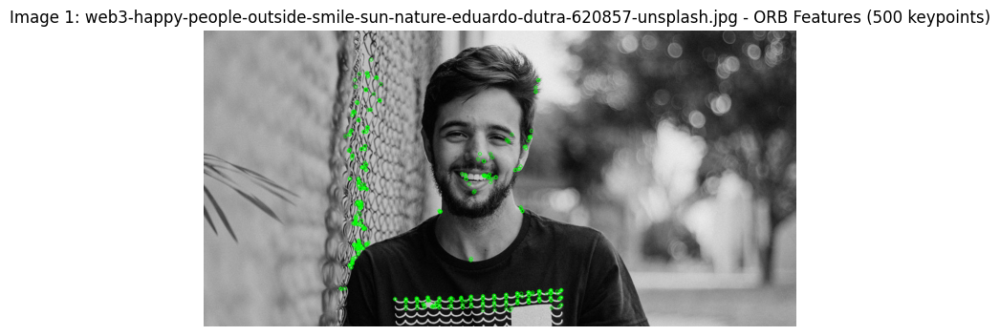


Detecting ORB features on: 1_617fd1e2590c2.jpg


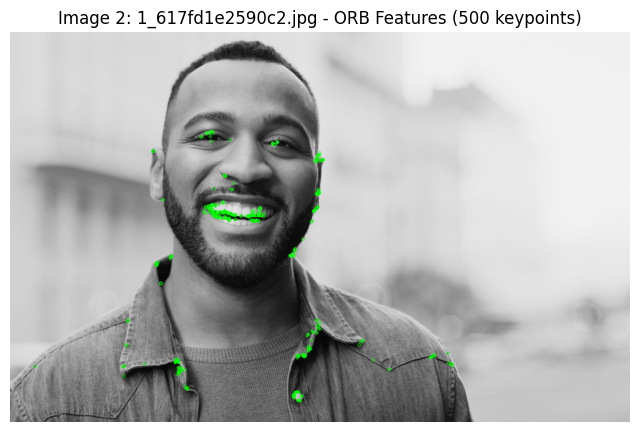

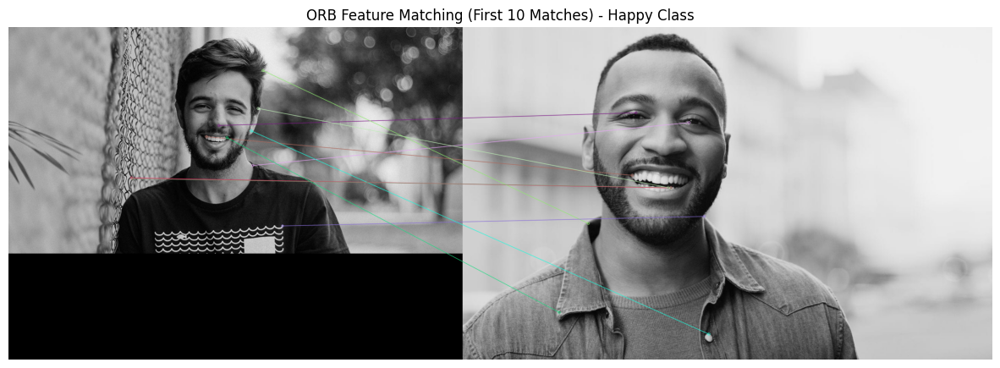

In [28]:
# prompt: Use ORB to detect features on two images for happy class

# Function to detect ORB features and draw them on an image
def detect_and_draw_orb(image_path, title):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE) # Read in grayscale

    if img is None:
        print(f"Could not read image: {image_path}")
        return

    # Initialize ORB detector
    orb = cv2.ORB_create()

    # Find the keypoints and descriptors with ORB
    kp, des = orb.detectAndCompute(img, None)

    # Draw only the keypoints on the image without size or orientation
    img_with_keypoints = cv2.drawKeypoints(img, kp, None, color=(0, 255, 0), flags=0)

    plt.figure(figsize=(8, 6))
    plt.imshow(img_with_keypoints, cmap='gray')
    plt.title(f'{title} - ORB Features ({len(kp)} keypoints)')
    plt.axis('off')
    plt.show()

    return kp, des, img

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'happy')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if len(image_files) >= 2:
        # Take the first two images for comparison
        image_path1 = os.path.join(happy_images_dir, image_files[0])
        image_path2 = os.path.join(happy_images_dir, image_files[5])

        print(f"Detecting ORB features on: {image_files[0]}")
        kp1, des1, img1 = detect_and_draw_orb(image_path1, f'Image 1: {image_files[0]}')

        print(f"\nDetecting ORB features on: {image_files[1]}")
        kp2, des2, img2 = detect_and_draw_orb(image_path2, f'Image 2: {image_files[1]}')

        if des1 is not None and des2 is not None:
            # Create BFMatcher object
            bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

            # Match descriptors
            matches = bf.match(des1, des2)

            # Sort them in the order of their distance
            matches = sorted(matches, key = lambda x:x.distance)

            # Draw first 10 matches
            # The last parameter (flags) is Optional. If set to DrawMatchesFlags.NOT_DRAW_SINGLE_POINTS, single points won't be drawn.
            img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

            plt.figure(figsize=(15, 10))
            plt.imshow(img_matches)
            plt.title("ORB Feature Matching (First 10 Matches) - Happy Class")
            plt.axis('off')
            plt.show()
        else:
            print("Could not compute descriptors for matching.")

    else:
        print(f"Need at least two image files in '{happy_images_dir}' to perform feature matching.")
else:
    print(f"Directory not found: {happy_images_dir}")

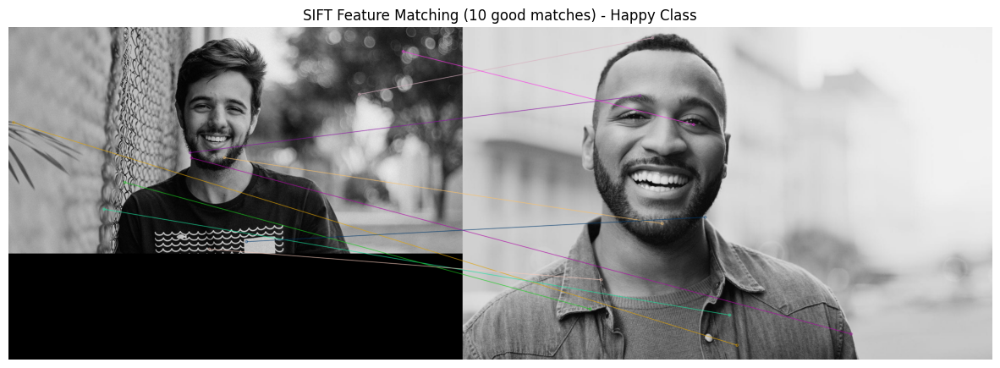

Image 1 (web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg): Detected 2411 SIFT keypoints.
Image 2 (05-12-21-happy-people.jpg): Detected 2005 SIFT keypoints.
Found 10 good matches using ratio test.


In [29]:
# prompt: SIFT to detect features on two images per happy class

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'happy')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if len(image_files) >= 2:
        # Take the first two images for comparison from the 'happy' class
        image_path1 = os.path.join(happy_images_dir, image_files[0])
        image_path2 = os.path.join(happy_images_dir, image_files[5]) # Using the second image

        # Read images in grayscale
        img1 = cv2.imread(image_path1, cv2.IMREAD_GRAYSCALE)
        img2 = cv2.imread(image_path2, cv2.IMREAD_GRAYSCALE)

        if img1 is not None and img2 is not None:
            # Initialize SIFT detector
            # Check OpenCV version to handle API changes if needed
            try:
                sift = cv2.SIFT_create()
            except AttributeError:
                print("SIFT_create() not found. You might need to install `opencv-contrib-python` or check your OpenCV version.")
                # Fallback for older OpenCV versions if necessary, though SIFT is non-free in later ones
                # sift = cv2.xfeatures2d.SIFT_create() # Requires opencv-contrib-python

            # Find the keypoints and descriptors with SIFT
            kp1, des1 = sift.detectAndCompute(img1, None)
            kp2, des2 = sift.detectAndCompute(img2, None)

            if des1 is not None and des2 is not None:
                # BFMatcher with default parameters (L2 norm for SIFT)
                bf = cv2.BFMatcher()

                # Match descriptors
                # Use k=2 to find the two best matches for each descriptor
                matches = bf.knnMatch(des1, des2, k=2)

                # Apply ratio test
                good_matches = []
                for m, n in matches:
                    if m.distance < 0.75 * n.distance: # Lowe's ratio test
                        good_matches.append(m)

                # Draw the good matches
                img_matches = cv2.drawMatches(img1, kp1, img2, kp2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

                plt.figure(figsize=(15, 10))
                plt.imshow(img_matches)
                plt.title(f"SIFT Feature Matching ({len(good_matches)} good matches) - Happy Class")
                plt.axis('off')
                plt.show()

                print(f"Image 1 ({os.path.basename(image_files[0])}): Detected {len(kp1)} SIFT keypoints.")
                print(f"Image 2 ({os.path.basename(image_files[5])}): Detected {len(kp2)} SIFT keypoints.")
                print(f"Found {len(good_matches)} good matches using ratio test.")

            else:
                print("Could not compute SIFT descriptors for matching.")

        else:
            print(f"Could not read one or both image files from '{happy_images_dir}'.")
    else:
        print(f"Need at least two image files in '{happy_images_dir}' to perform SIFT feature matching.")
else:
    print(f"Directory not found: {happy_images_dir}")

Detecting ORB features on: 68-688804_angry-person-png-images-angry-man-transparent-png.png


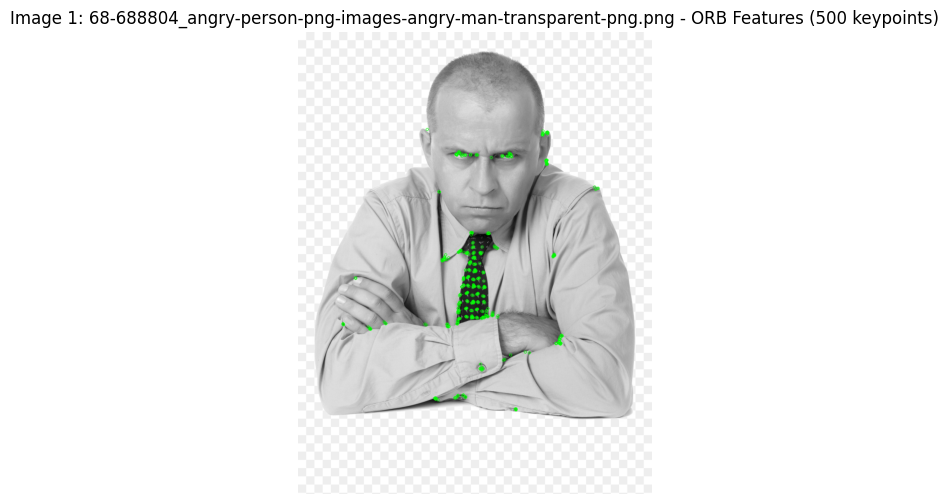


Detecting ORB features on: Angry-Customer.jpg


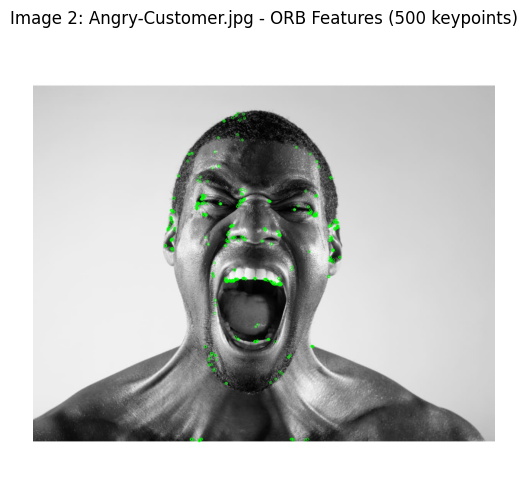

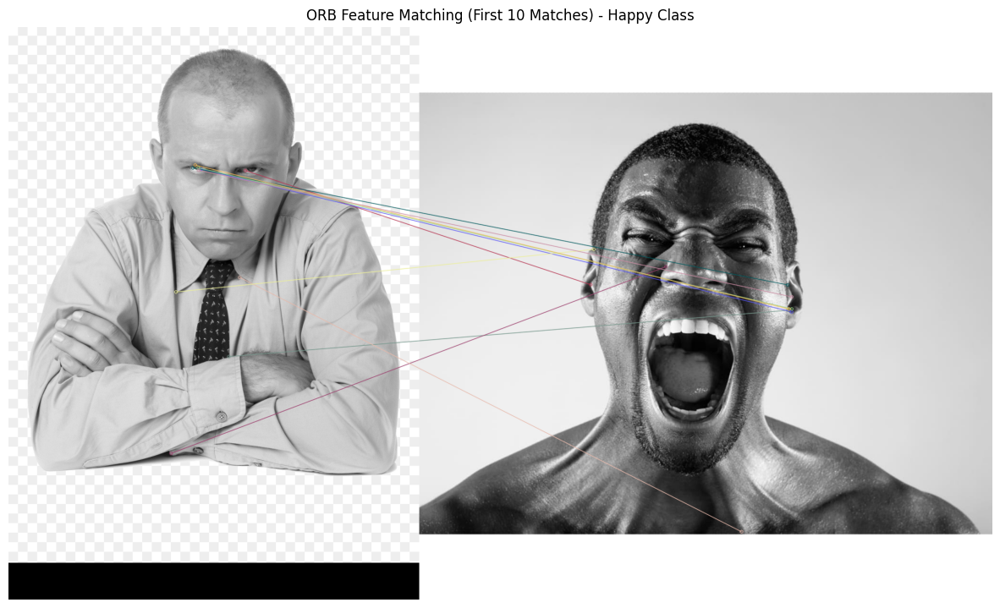

In [30]:
# prompt: Use ORB to detect features on two images for angry class

# Function to detect ORB features and draw them on an image
def detect_and_draw_orb(image_path, title):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE) # Read in grayscale

    if img is None:
        print(f"Could not read image: {image_path}")
        return

    # Initialize ORB detector
    orb = cv2.ORB_create()

    # Find the keypoints and descriptors with ORB
    kp, des = orb.detectAndCompute(img, None)

    # Draw only the keypoints on the image without size or orientation
    img_with_keypoints = cv2.drawKeypoints(img, kp, None, color=(0, 255, 0), flags=0)

    plt.figure(figsize=(8, 6))
    plt.imshow(img_with_keypoints, cmap='gray')
    plt.title(f'{title} - ORB Features ({len(kp)} keypoints)')
    plt.axis('off')
    plt.show()

    return kp, des, img

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'angry')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if len(image_files) >= 2:
        # Take the first two images for comparison
        image_path1 = os.path.join(happy_images_dir, image_files[2])
        image_path2 = os.path.join(happy_images_dir, image_files[5])

        print(f"Detecting ORB features on: {image_files[0]}")
        kp1, des1, img1 = detect_and_draw_orb(image_path1, f'Image 1: {image_files[0]}')

        print(f"\nDetecting ORB features on: {image_files[1]}")
        kp2, des2, img2 = detect_and_draw_orb(image_path2, f'Image 2: {image_files[1]}')

        if des1 is not None and des2 is not None:
            # Create BFMatcher object
            bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

            # Match descriptors
            matches = bf.match(des1, des2)

            # Sort them in the order of their distance
            matches = sorted(matches, key = lambda x:x.distance)

            # Draw first 10 matches
            # The last parameter (flags) is Optional. If set to DrawMatchesFlags.NOT_DRAW_SINGLE_POINTS, single points won't be drawn.
            img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

            plt.figure(figsize=(15, 10))
            plt.imshow(img_matches)
            plt.title("ORB Feature Matching (First 10 Matches) - Happy Class")
            plt.axis('off')
            plt.show()
        else:
            print("Could not compute descriptors for matching.")

    else:
        print(f"Need at least two image files in '{happy_images_dir}' to perform feature matching.")
else:
    print(f"Directory not found: {happy_images_dir}")

Detecting ORB features on: Neutral.jpg


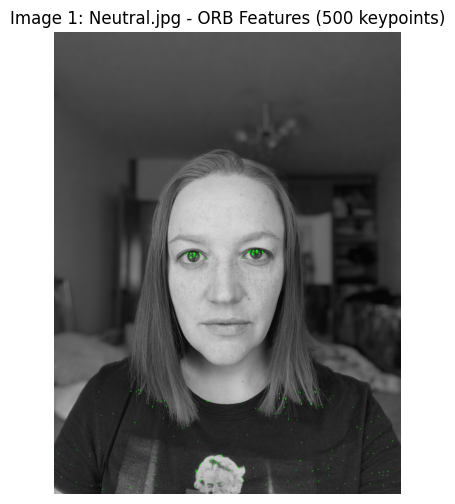


Detecting ORB features on: Neutral (1).jpg


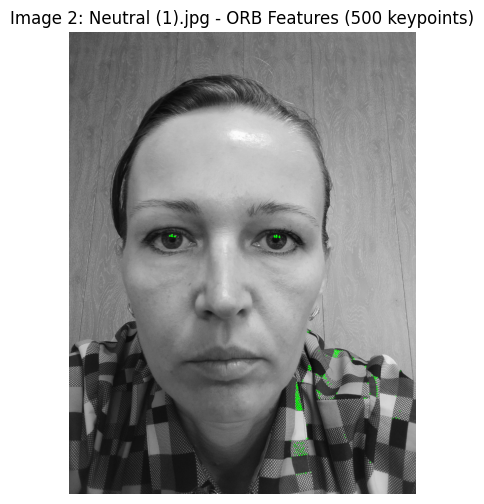

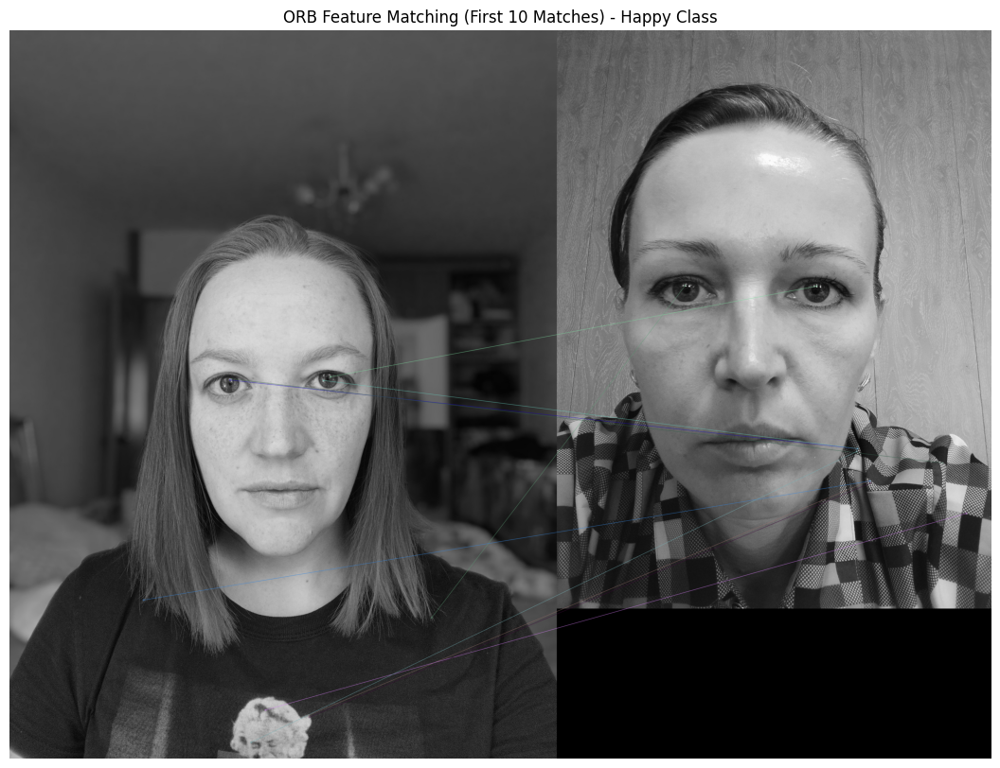

In [31]:
# prompt: Use ORB to detect features on two images for neutral class

# Function to detect ORB features and draw them on an image
def detect_and_draw_orb(image_path, title):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE) # Read in grayscale

    if img is None:
        print(f"Could not read image: {image_path}")
        return

    # Initialize ORB detector
    orb = cv2.ORB_create()

    # Find the keypoints and descriptors with ORB
    kp, des = orb.detectAndCompute(img, None)

    # Draw only the keypoints on the image without size or orientation
    img_with_keypoints = cv2.drawKeypoints(img, kp, None, color=(0, 255, 0), flags=0)

    plt.figure(figsize=(8, 6))
    plt.imshow(img_with_keypoints, cmap='gray')
    plt.title(f'{title} - ORB Features ({len(kp)} keypoints)')
    plt.axis('off')
    plt.show()

    return kp, des, img

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'neutral')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if len(image_files) >= 2:
        # Take the first two images for comparison
        image_path1 = os.path.join(happy_images_dir, image_files[1])
        image_path2 = os.path.join(happy_images_dir, image_files[5])

        print(f"Detecting ORB features on: {image_files[0]}")
        kp1, des1, img1 = detect_and_draw_orb(image_path1, f'Image 1: {image_files[0]}')

        print(f"\nDetecting ORB features on: {image_files[1]}")
        kp2, des2, img2 = detect_and_draw_orb(image_path2, f'Image 2: {image_files[1]}')

        if des1 is not None and des2 is not None:
            # Create BFMatcher object
            bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

            # Match descriptors
            matches = bf.match(des1, des2)

            # Sort them in the order of their distance
            matches = sorted(matches, key = lambda x:x.distance)

            # Draw first 10 matches
            # The last parameter (flags) is Optional. If set to DrawMatchesFlags.NOT_DRAW_SINGLE_POINTS, single points won't be drawn.
            img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

            plt.figure(figsize=(15, 10))
            plt.imshow(img_matches)
            plt.title("ORB Feature Matching (First 10 Matches) - Happy Class")
            plt.axis('off')
            plt.show()
        else:
            print("Could not compute descriptors for matching.")

    else:
        print(f"Need at least two image files in '{happy_images_dir}' to perform feature matching.")
else:
    print(f"Directory not found: {happy_images_dir}")

Detecting ORB features on: 20201112-Alexithymia-844.jpg


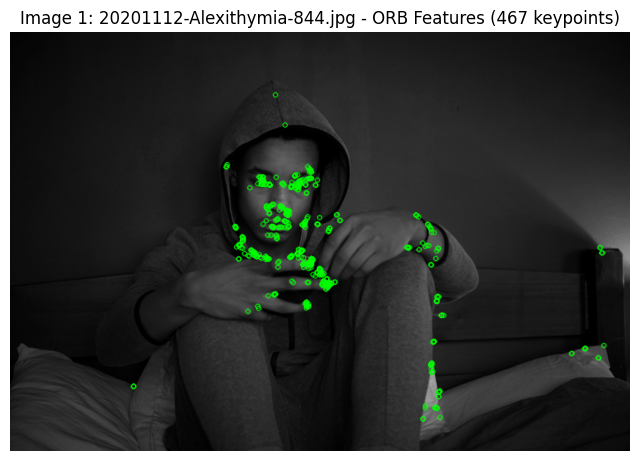


Detecting ORB features on: 405-4050267_sad-people-png-sad-person-transparent-background-png.png


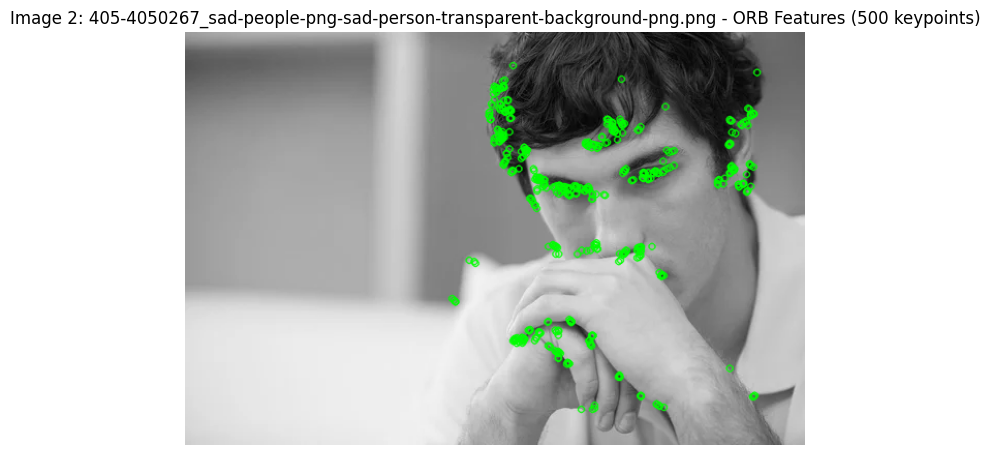

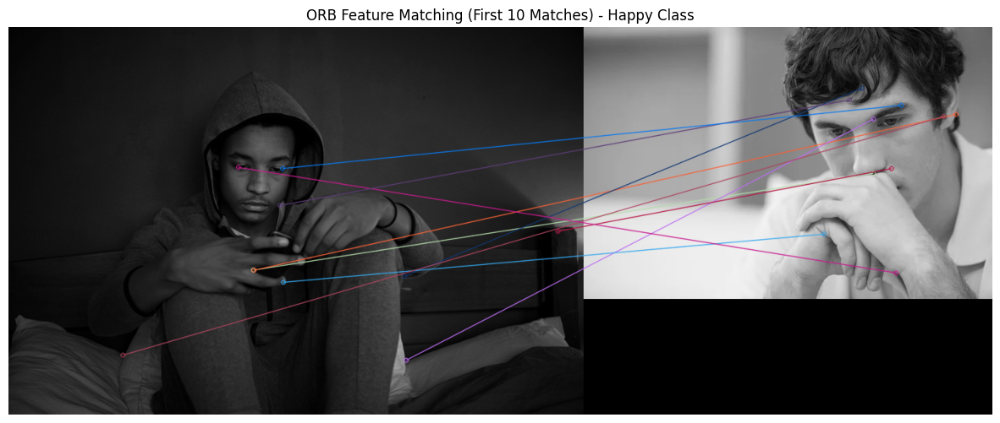

In [32]:
# prompt: Use ORB to detect features on two images for sad class

# Function to detect ORB features and draw them on an image
def detect_and_draw_orb(image_path, title):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE) # Read in grayscale

    if img is None:
        print(f"Could not read image: {image_path}")
        return

    # Initialize ORB detector
    orb = cv2.ORB_create()

    # Find the keypoints and descriptors with ORB
    kp, des = orb.detectAndCompute(img, None)

    # Draw only the keypoints on the image without size or orientation
    img_with_keypoints = cv2.drawKeypoints(img, kp, None, color=(0, 255, 0), flags=0)

    plt.figure(figsize=(8, 6))
    plt.imshow(img_with_keypoints, cmap='gray')
    plt.title(f'{title} - ORB Features ({len(kp)} keypoints)')
    plt.axis('off')
    plt.show()

    return kp, des, img

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'sad')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if len(image_files) >= 2:
        # Take the first two images for comparison
        image_path1 = os.path.join(happy_images_dir, image_files[0])
        image_path2 = os.path.join(happy_images_dir, image_files[5])

        print(f"Detecting ORB features on: {image_files[0]}")
        kp1, des1, img1 = detect_and_draw_orb(image_path1, f'Image 1: {image_files[0]}')

        print(f"\nDetecting ORB features on: {image_files[1]}")
        kp2, des2, img2 = detect_and_draw_orb(image_path2, f'Image 2: {image_files[1]}')

        if des1 is not None and des2 is not None:
            # Create BFMatcher object
            bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

            # Match descriptors
            matches = bf.match(des1, des2)

            # Sort them in the order of their distance
            matches = sorted(matches, key = lambda x:x.distance)

            # Draw first 10 matches
            # The last parameter (flags) is Optional. If set to DrawMatchesFlags.NOT_DRAW_SINGLE_POINTS, single points won't be drawn.
            img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

            plt.figure(figsize=(15, 10))
            plt.imshow(img_matches)
            plt.title("ORB Feature Matching (First 10 Matches) - Happy Class")
            plt.axis('off')
            plt.show()
        else:
            print("Could not compute descriptors for matching.")

    else:
        print(f"Need at least two image files in '{happy_images_dir}' to perform feature matching.")
else:
    print(f"Directory not found: {happy_images_dir}")

Detecting ORB features on: Surprised (6).jpg


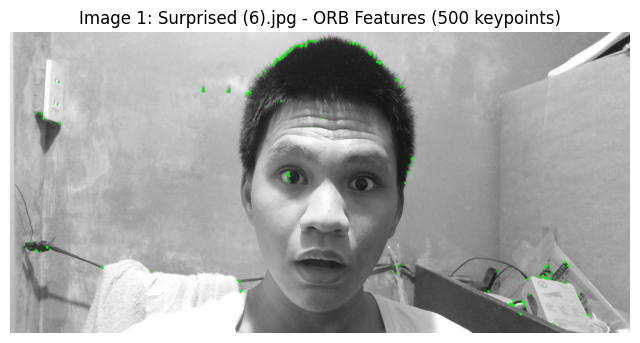


Detecting ORB features on: Surprised.jpg


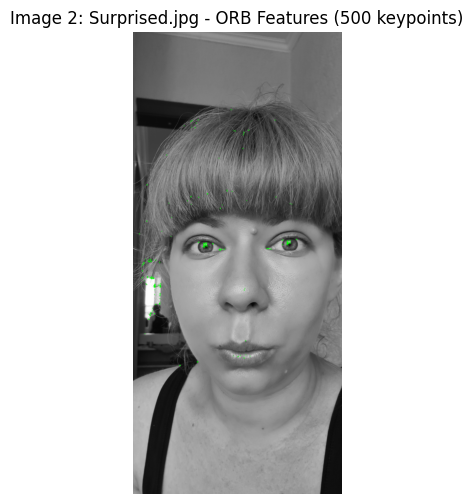

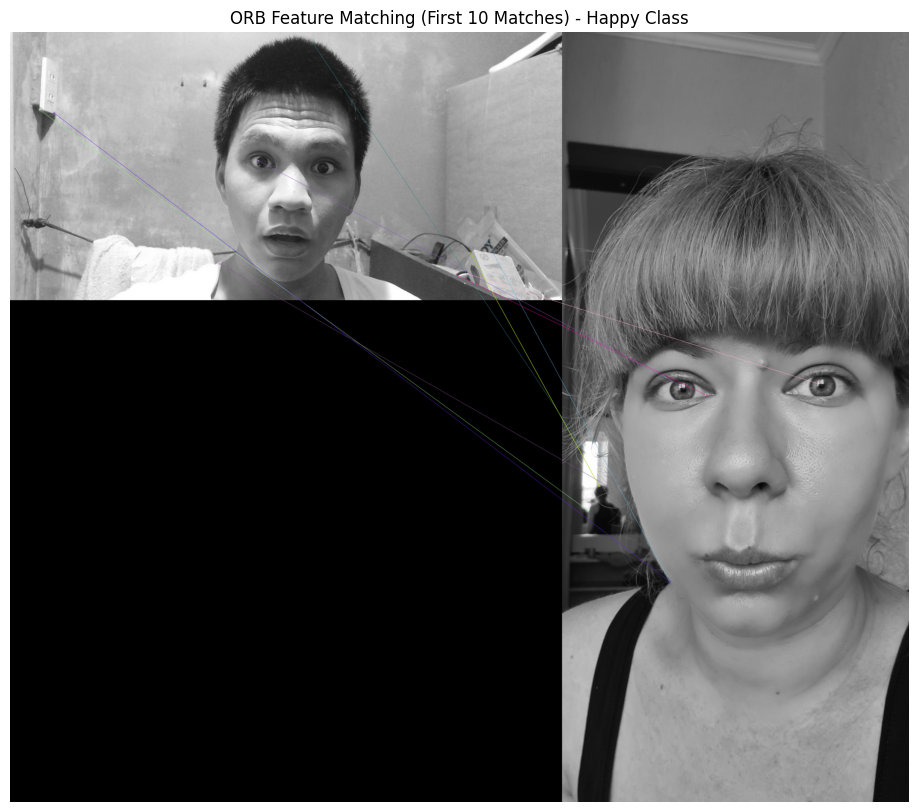

In [33]:
# prompt: Use ORB to detect features on two images for surprised class

# Function to detect ORB features and draw them on an image
def detect_and_draw_orb(image_path, title):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE) # Read in grayscale

    if img is None:
        print(f"Could not read image: {image_path}")
        return

    # Initialize ORB detector
    orb = cv2.ORB_create()

    # Find the keypoints and descriptors with ORB
    kp, des = orb.detectAndCompute(img, None)

    # Draw only the keypoints on the image without size or orientation
    img_with_keypoints = cv2.drawKeypoints(img, kp, None, color=(0, 255, 0), flags=0)

    plt.figure(figsize=(8, 6))
    plt.imshow(img_with_keypoints, cmap='gray')
    plt.title(f'{title} - ORB Features ({len(kp)} keypoints)')
    plt.axis('off')
    plt.show()

    return kp, des, img

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'surprised')

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg', '.gif'))]

    if len(image_files) >= 2:
        # Take the first two images for comparison
        image_path1 = os.path.join(happy_images_dir, image_files[3])
        image_path2 = os.path.join(happy_images_dir, image_files[5])

        print(f"Detecting ORB features on: {image_files[0]}")
        kp1, des1, img1 = detect_and_draw_orb(image_path1, f'Image 1: {image_files[0]}')

        print(f"\nDetecting ORB features on: {image_files[1]}")
        kp2, des2, img2 = detect_and_draw_orb(image_path2, f'Image 2: {image_files[1]}')

        if des1 is not None and des2 is not None:
            # Create BFMatcher object
            bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)

            # Match descriptors
            matches = bf.match(des1, des2)

            # Sort them in the order of their distance
            matches = sorted(matches, key = lambda x:x.distance)

            # Draw first 10 matches
            # The last parameter (flags) is Optional. If set to DrawMatchesFlags.NOT_DRAW_SINGLE_POINTS, single points won't be drawn.
            img_matches = cv2.drawMatches(img1, kp1, img2, kp2, matches[:10], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

            plt.figure(figsize=(15, 10))
            plt.imshow(img_matches)
            plt.title("ORB Feature Matching (First 10 Matches) - Happy Class")
            plt.axis('off')
            plt.show()
        else:
            print("Could not compute descriptors for matching.")

    else:
        print(f"Need at least two image files in '{happy_images_dir}' to perform feature matching.")
else:
    print(f"Directory not found: {happy_images_dir}")

# **Discuss how features differ across sentiments.**
In the context of facial sentiment analysis, certain features such as the eyes are consistently significant across all emotional expressions. However, specific emotions tend to emphasize additional facial elements. For example, emotions like happiness or anger may rely more heavily on the shape and movement of the lips, eyebrows, and overall facial musculature. In contrast, expressions of surprise often exhibit fewer distinctive features, making them more challenging to detect accurately. Additionally, some images classified as "happy" appear to incorporate irrelevant or non-facial elements such as a background fence which may detract from the accuracy of the analysis. On the other hand, images labeled as "sad" generally present more meaningful and distinct facial features closely aligned with that particular emotion.

# **Cloud Inference**

In [34]:
# ---------------------------------------------
# STEP 1: Install and Authenticate Google Cloud
# ---------------------------------------------
!pip install --quiet google-cloud-vision

from google.colab import auth
auth.authenticate_user()

from google.cloud import vision
import io
import time
import os
import pandas as pd

# Initialize Vision API client
client = vision.ImageAnnotatorClient()

# ---------------------------------------------
# STEP 2: Mount Google Drive (if using Drive)
# ---------------------------------------------
from google.colab import drive
drive.mount('/content/drive')

# Set your data directory inside Drive (modify this)
data_dir = '/content/drive/MyDrive/Computer Vision/LAB1'  # Replace with your actual folder path
emotions = ['Happy', 'Sad', 'Angry', 'Suprised', 'Neutral']  # Adjust based on your folder names

# ---------------------------------------------
# STEP 3: Define the Prediction Function
# ---------------------------------------------
def cloud_predict(img_path):
    """
    Predicts the emotional sentiment of an image using Google Cloud Vision API.

    Args:
      img_path (str): The path to the image file.

    Returns:
      tuple: (label, confidence, latency) or fallback values if failed.
    """
    try:
        with io.open(img_path, 'rb') as image_file:
            content = image_file.read()

        image = vision.Image(content=content)

        start_time = time.time()
        response = client.face_detection(image=image)
        latency = time.time() - start_time

        if response.face_annotations:
            face = response.face_annotations[0]

            likelihood_score = {
                vision.Likelihood.UNKNOWN: 0.0,
                vision.Likelihood.VERY_UNLIKELY: 0.1,
                vision.Likelihood.UNLIKELY: 0.3,
                vision.Likelihood.POSSIBLE: 0.5,
                vision.Likelihood.LIKELY: 0.7,
                vision.Likelihood.VERY_LIKELY: 0.9
            }

            emotions_likelihood = {
                'joy': likelihood_score[face.joy_likelihood],
                'sorrow': likelihood_score[face.sorrow_likelihood],
                'anger': likelihood_score[face.anger_likelihood],
                'surprise': likelihood_score[face.surprise_likelihood],
            }

            # Filter weak predictions
            max_conf = max(emotions_likelihood.values())
            if max_conf < 0.3:
                return 'neutral', max_conf, latency

            dominant_emotion = max(emotions_likelihood, key=emotions_likelihood.get)
            emotion_map = {
                'joy': 'happy',
                'sorrow': 'sad',
                'anger': 'angry',
                'surprise': 'surprised'
            }
            mapped_label = emotion_map.get(dominant_emotion, 'neutral')
            return mapped_label, max_conf, latency

        else:
            print(f"No face detected in: {img_path}")
            return 'none', 0.0, latency

    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return None, None, None

# ---------------------------------------------
# STEP 4: Gather Test Images (One per Emotion)
# ---------------------------------------------
test_image_paths = []

for emo in emotions:
    emo_dir = os.path.join(data_dir, emo)
    if os.path.exists(emo_dir):
        image_files = [f for f in os.listdir(emo_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
        if image_files:
            test_image_paths.append(os.path.join(emo_dir, image_files[0]))
        else:
            print(f"⚠️ No images found in: {emo_dir}")
    else:
        print(f"⚠️ Directory does not exist: {emo_dir}")

if len(test_image_paths) < 5:
    print(f"⚠️ Warning: Only {len(test_image_paths)} emotion images found.")

# ---------------------------------------------
# STEP 5: Run Predictions and Show Results
# ---------------------------------------------
prediction_results = []

print("\n🔍 Performing Cloud Inference:")
for img_path in test_image_paths:
    print(f"\nAnalyzing: {img_path}")
    label, confidence, latency = cloud_predict(img_path)

    if label is not None:
        result = {
            'Image': os.path.basename(img_path),
            'Predicted Label': label,
            'Confidence': round(confidence, 3),
            'Latency (s)': round(latency, 3)
        }
        prediction_results.append(result)
        print(f"  ✅ Label: {label}, Confidence: {confidence:.3f}, Latency: {latency:.3f}s")
    else:
        print(f"  ❌ Failed to predict: {img_path}")

# ---------------------------------------------
# STEP 6: Display Summary Table
# ---------------------------------------------
print("\n📊 Prediction Summary:")
df = pd.DataFrame(prediction_results)
print(df)

# Optional: Save to CSV
# df.to_csv('/content/drive/MyDrive/prediction_summary.csv', index=False)


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 319.9/319.9 kB 5.0 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.12.0 requires numpy<1.24,>=1.22, but you have numpy 1.26.4 which is incompatible.
tensorflow 2.12.0 requires protobuf!=4.21.0,!=4.21.1,!=4.21.2,!=4.21.3,!=4.21.4,!=4.21.5,<5.0.0dev,>=3.20.3, but you have protobuf 5.29.5 which is incompatible.
tf-keras 2.18.0 requires tensorflow<2.19,>=2.18, but you have tensorflow 2.12.0 which is incompatible.
tensorflow-decision-forests 1.11.0 requires tensorflow==2.18.0, but you have tensorflow 2.12.0 which is incompatible.
orbax-checkpoint 0.11.13 requires jax>=0.5.0, but you have jax 0.4.30 which is incompatible.
tensorflow-text 2.18.1 requires tensorflow<2.19,>=2.18.0, but you have tensorflow 2.12.0 which is incompatible.
Drive already mounted at /content/drive; to attempt to forcibly


Performing FER analysis on 'happy' class images:
  Analyzed 1_617fd1e2590c2.jpg: Detected 4 face(s), Dominant: happy (1.000)


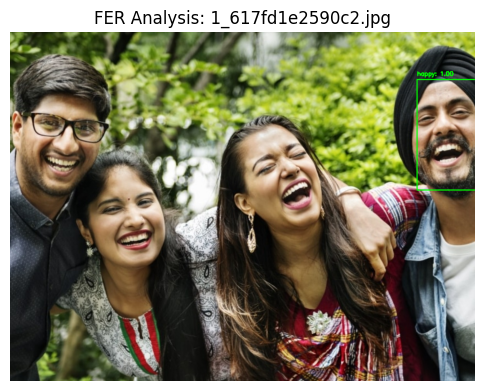

  Analyzed 1HEoLBLidT2u4mhJ0oiDgig.png: Detected 1 face(s), Dominant: happy (1.000)


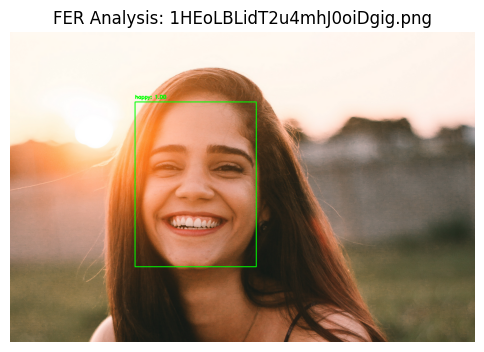

  Analyzed 05-12-21-happy-people.jpg: Detected 1 face(s), Dominant: happy (1.000)


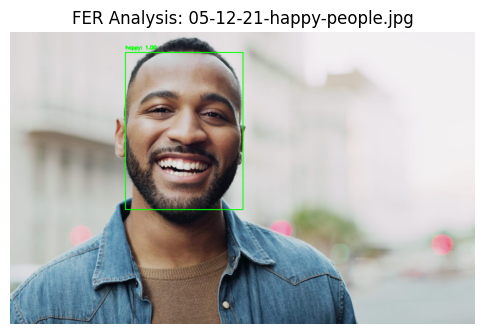

  Analyzed 2560px-Happy_People.jpg: Detected 4 face(s), Dominant: happy (0.820)


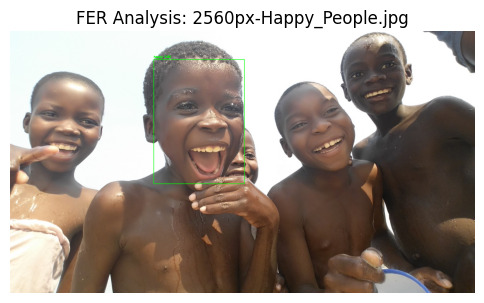

  Analyzed 427394C200000578-0-image-a-24_1500384481554.jpg: Detected 1 face(s), Dominant: happy (0.880)


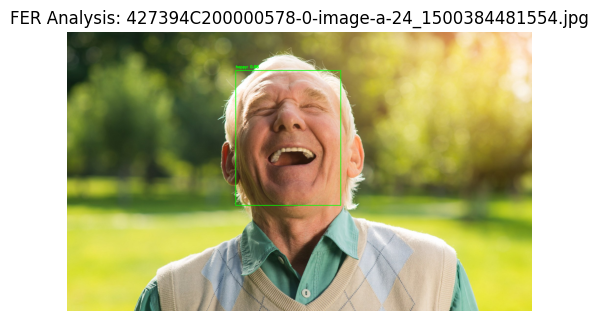

  Analyzed dv2051009.jpg: Detected 1 face(s), Dominant: happy (0.930)


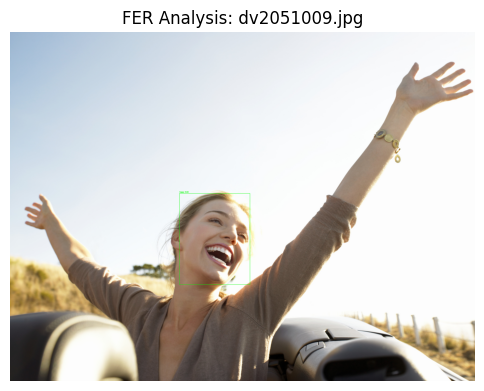

  Analyzed web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg: Detected 1 face(s), Dominant: happy (1.000)


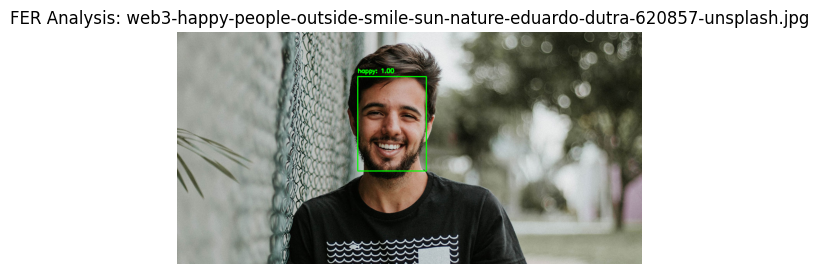

  Analyzed riskshappypeopletakeh_1384254283.jpg: Detected 1 face(s), Dominant: happy (0.820)


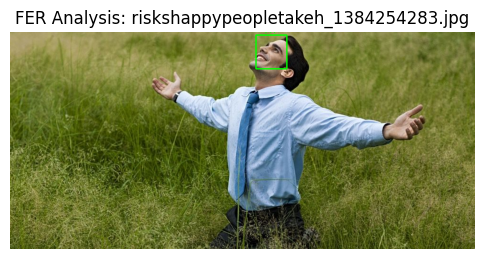

  Analyzed Happy-people-800x533.jpg: Detected 3 face(s), Dominant: happy (1.000)


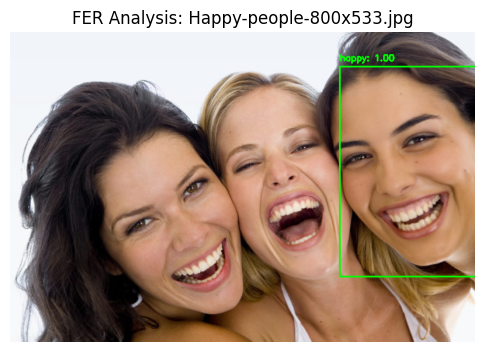

  Analyzed happy-people12.jpg: Detected 1 face(s), Dominant: happy (0.970)


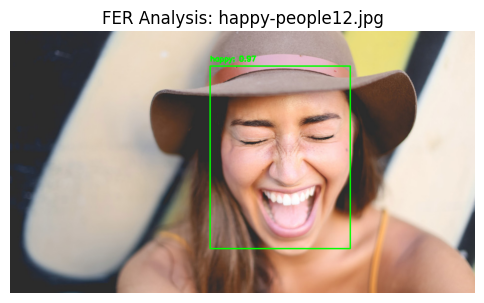


📊 FER Analysis Summary ('happy' class):
                                               Image  Detected Face Count  \
0                                1_617fd1e2590c2.jpg                    4   
1                        1HEoLBLidT2u4mhJ0oiDgig.png                    1   
2                          05-12-21-happy-people.jpg                    1   
3                            2560px-Happy_People.jpg                    4   
4    427394C200000578-0-image-a-24_1500384481554.jpg                    1   
5                                      dv2051009.jpg                    1   
6  web3-happy-people-outside-smile-sun-nature-edu...                    1   
7               riskshappypeopletakeh_1384254283.jpg                    1   
8                           Happy-people-800x533.jpg                    3   
9                                 happy-people12.jpg                    1   

  Dominant Emotion  Dominant Score  \
0            happy            1.00   
1            happy            1.00 

In [36]:
# prompt: Use FER in a sentimental analisys of the pictures in Happy class

!pip install fer

from fer import FER
import matplotlib.pyplot as plt
import os

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'Happy')

# Initialize the FER detector
detector = FER(mtcnn=True) # Use MTCNN for face detection (more robust)

print("\nPerforming FER analysis on 'happy' class images:")

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if image_files:
        fer_results = []
        for image_file in image_files:
            image_path = os.path.join(happy_images_dir, image_file)

            try:
                # Read the image
                img = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # FER expects RGB

                # Detect emotions
                # The detect_emotions() method returns a list of dictionaries,
                # one for each face detected. Each dictionary contains bounding box
                # and emotion scores.
                results = detector.detect_emotions(img_rgb)

                if results:
                    # Assuming one face per image for simplicity, take the first result
                    face_result = results[0]
                    emotions_scores = face_result['emotions']

                    # Get the dominant emotion
                    dominant_emotion = max(emotions_scores, key=emotions_scores.get)
                    dominant_score = emotions_scores[dominant_emotion]

                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': len(results),
                        'Dominant Emotion': dominant_emotion,
                        'Dominant Score': round(dominant_score, 3),
                        'All Emotions': emotions_scores
                    })
                    print(f"  Analyzed {image_file}: Detected {len(results)} face(s), Dominant: {dominant_emotion} ({dominant_score:.3f})")

                    # Optional: Draw bounding box and emotion on the image
                    bbox = face_result['box']
                    x, y, w, h = bbox
                    cv2.rectangle(img_rgb, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    # Put text for dominant emotion and score
                    text = f"{dominant_emotion}: {dominant_score:.2f}"
                    cv2.putText(img_rgb, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

                    plt.figure(figsize=(6, 6))
                    plt.imshow(img_rgb)
                    plt.title(f"FER Analysis: {image_file}")
                    plt.axis('off')
                    plt.show()


                else:
                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': 0,
                        'Dominant Emotion': 'none',
                        'Dominant Score': 0.0,
                        'All Emotions': {}
                    })
                    print(f"  Analyzed {image_file}: No face detected.")

            except Exception as e:
                print(f"  Error processing {image_file}: {e}")
                fer_results.append({
                    'Image': image_file,
                    'Detected Face Count': 'Error',
                    'Dominant Emotion': 'Error',
                    'Dominant Score': 'Error',
                    'All Emotions': 'Error'
                })

        # Display summary table
        print("\n📊 FER Analysis Summary ('happy' class):")
        df_fer = pd.DataFrame(fer_results)
        print(df_fer)

    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")



Performing FER analysis on 'happy' class images:
  Analyzed 68-688804_angry-person-png-images-angry-man-transparent-png.png: Detected 1 face(s), Dominant: angry (0.440)


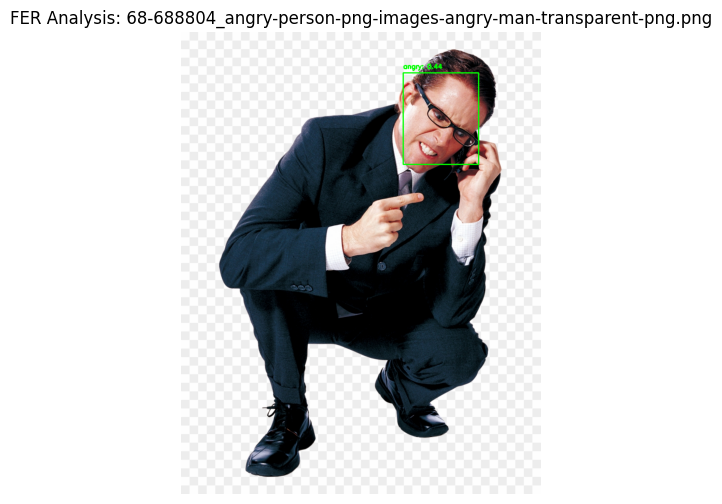

  Analyzed 118-1183761_angry-person-transparent-images-png-angry-man-png.png: Detected 1 face(s), Dominant: angry (0.880)


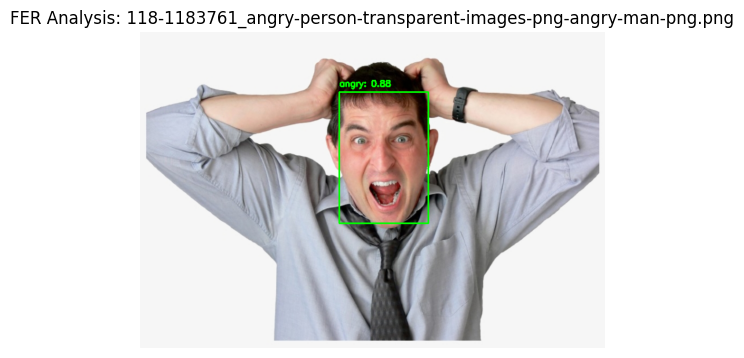

  Analyzed 118-1183847_angry-person-png-picture.png: Detected 1 face(s), Dominant: angry (0.920)


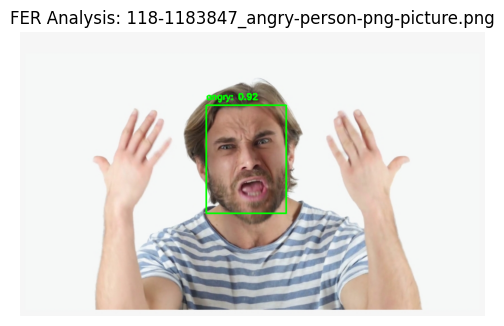

  Analyzed 439-4398363_angry-man-png-pictures-angry-person-png-transparent.png: Detected 1 face(s), Dominant: angry (0.700)


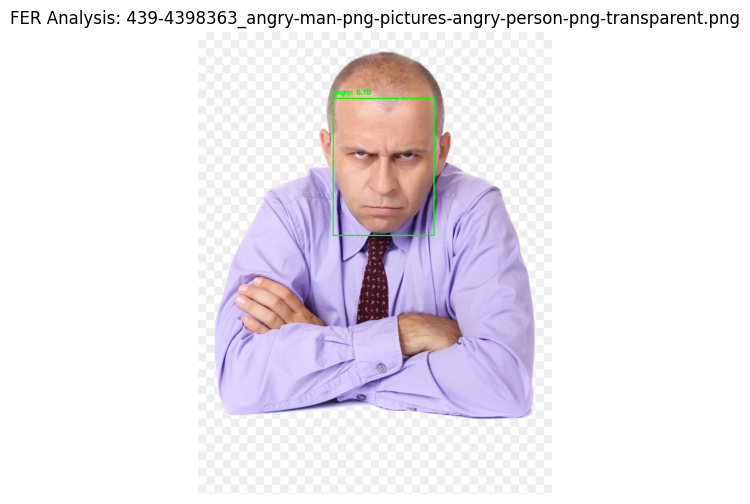

  Analyzed 800px-Angry-2766265_960_720.jpg: Detected 1 face(s), Dominant: neutral (0.550)


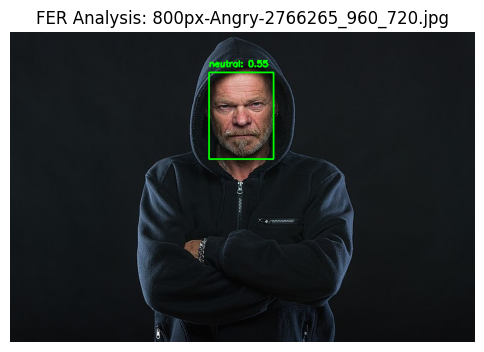

  Analyzed Anger_Controlls_Him.jpg: Detected 1 face(s), Dominant: angry (0.910)


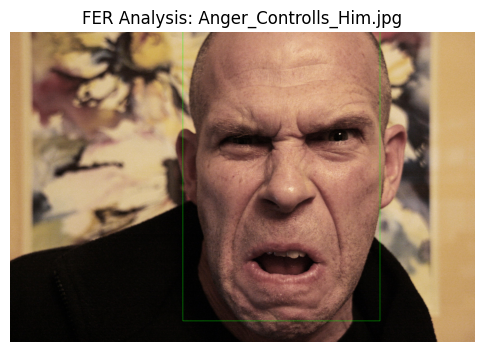

  Analyzed anger_ruining_898.jpg: Detected 1 face(s), Dominant: sad (0.650)


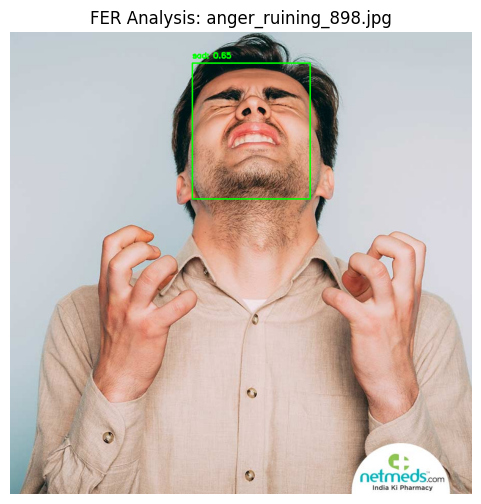

  Analyzed anger-18615_640.jpg: Detected 1 face(s), Dominant: angry (0.970)


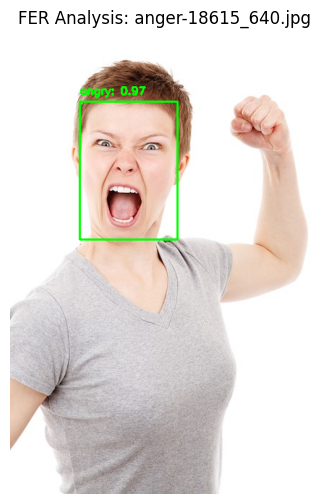

  Analyzed anger-can-kill-you-main.jpg: Detected 1 face(s), Dominant: fear (0.530)


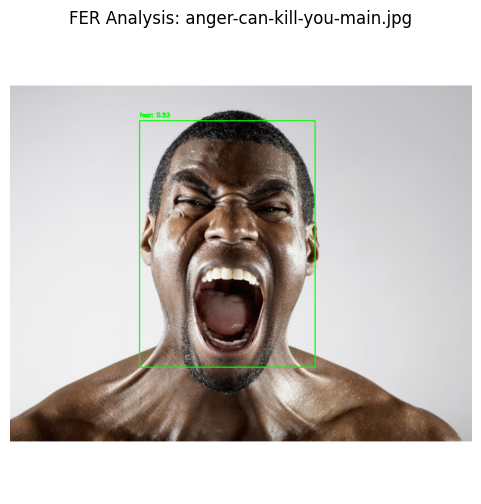

  Analyzed Angry-Customer.jpg: Detected 2 face(s), Dominant: angry (0.670)


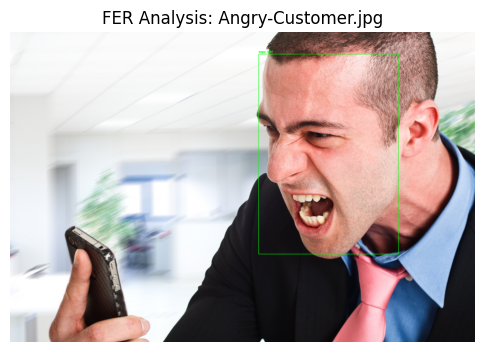


📊 FER Analysis Summary ('happy' class):
                                               Image  Detected Face Count  \
0  68-688804_angry-person-png-images-angry-man-tr...                    1   
1  118-1183761_angry-person-transparent-images-pn...                    1   
2           118-1183847_angry-person-png-picture.png                    1   
3  439-4398363_angry-man-png-pictures-angry-perso...                    1   
4                    800px-Angry-2766265_960_720.jpg                    1   
5                            Anger_Controlls_Him.jpg                    1   
6                              anger_ruining_898.jpg                    1   
7                                anger-18615_640.jpg                    1   
8                        anger-can-kill-you-main.jpg                    1   
9                                 Angry-Customer.jpg                    2   

  Dominant Emotion  Dominant Score  \
0            angry            0.44   
1            angry            0.88 

In [37]:
# prompt: Use FER in a sentimental analisys of the pictures in Happy class

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'Angry')

# Initialize the FER detector
detector = FER(mtcnn=True) # Use MTCNN for face detection (more robust)

print("\nPerforming FER analysis on 'happy' class images:")

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if image_files:
        fer_results = []
        for image_file in image_files:
            image_path = os.path.join(happy_images_dir, image_file)

            try:
                # Read the image
                img = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # FER expects RGB

                # Detect emotions
                # The detect_emotions() method returns a list of dictionaries,
                # one for each face detected. Each dictionary contains bounding box
                # and emotion scores.
                results = detector.detect_emotions(img_rgb)

                if results:
                    # Assuming one face per image for simplicity, take the first result
                    face_result = results[0]
                    emotions_scores = face_result['emotions']

                    # Get the dominant emotion
                    dominant_emotion = max(emotions_scores, key=emotions_scores.get)
                    dominant_score = emotions_scores[dominant_emotion]

                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': len(results),
                        'Dominant Emotion': dominant_emotion,
                        'Dominant Score': round(dominant_score, 3),
                        'All Emotions': emotions_scores
                    })
                    print(f"  Analyzed {image_file}: Detected {len(results)} face(s), Dominant: {dominant_emotion} ({dominant_score:.3f})")

                    # Optional: Draw bounding box and emotion on the image
                    bbox = face_result['box']
                    x, y, w, h = bbox
                    cv2.rectangle(img_rgb, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    # Put text for dominant emotion and score
                    text = f"{dominant_emotion}: {dominant_score:.2f}"
                    cv2.putText(img_rgb, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

                    plt.figure(figsize=(6, 6))
                    plt.imshow(img_rgb)
                    plt.title(f"FER Analysis: {image_file}")
                    plt.axis('off')
                    plt.show()


                else:
                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': 0,
                        'Dominant Emotion': 'none',
                        'Dominant Score': 0.0,
                        'All Emotions': {}
                    })
                    print(f"  Analyzed {image_file}: No face detected.")

            except Exception as e:
                print(f"  Error processing {image_file}: {e}")
                fer_results.append({
                    'Image': image_file,
                    'Detected Face Count': 'Error',
                    'Dominant Emotion': 'Error',
                    'Dominant Score': 'Error',
                    'All Emotions': 'Error'
                })

        # Display summary table
        print("\n📊 FER Analysis Summary ('happy' class):")
        df_fer = pd.DataFrame(fer_results)
        print(df_fer)

    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")



Performing FER analysis on 'happy' class images:
  Analyzed Neutral.jpg: Detected 1 face(s), Dominant: neutral (0.770)


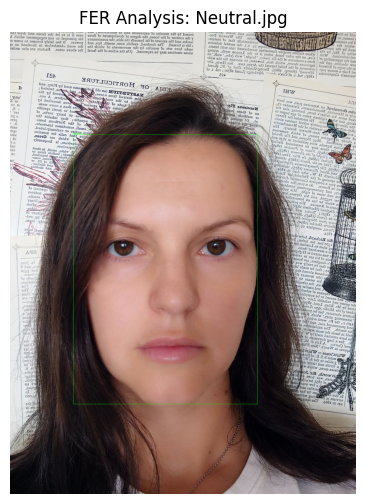

  Analyzed Neutral (1).jpg: Detected 1 face(s), Dominant: neutral (0.770)


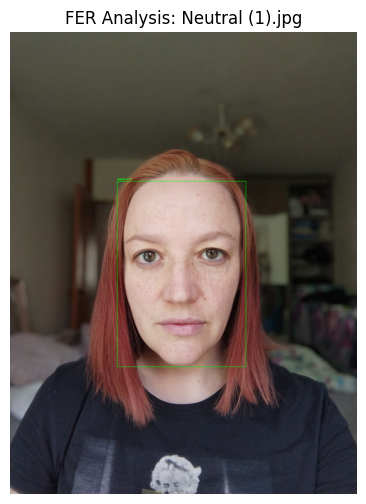

  Analyzed Neutral (2).jpg: Detected 1 face(s), Dominant: neutral (0.520)


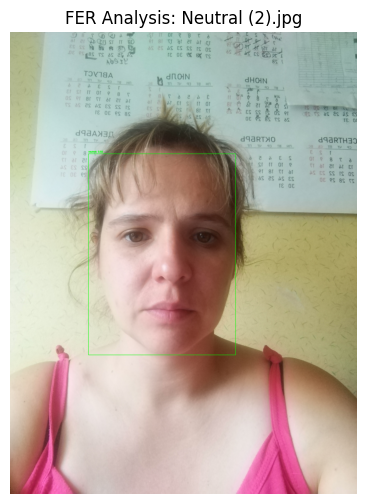

  Analyzed Neutral (3).jpg: Detected 1 face(s), Dominant: neutral (0.720)


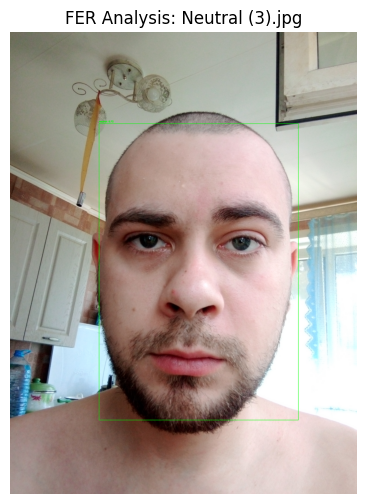

  Analyzed Neutral (4).jpg: Detected 1 face(s), Dominant: neutral (0.900)


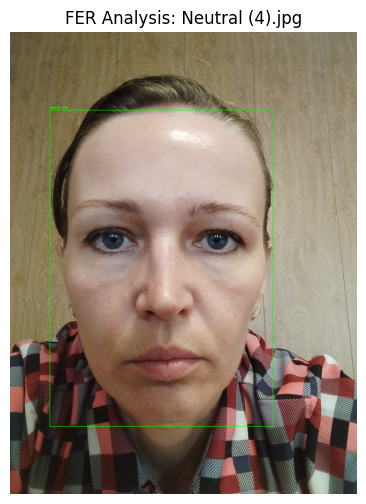

  Analyzed Neutral (5).jpg: Detected 1 face(s), Dominant: neutral (0.590)


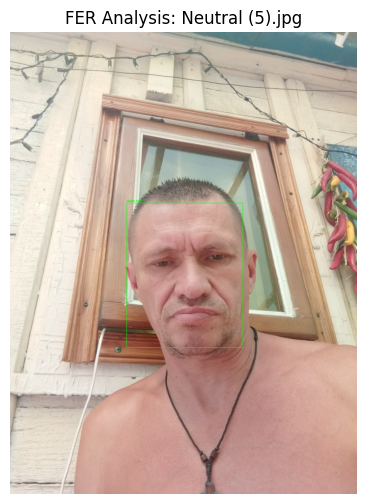

  Analyzed Neutral (6).jpg: Detected 1 face(s), Dominant: neutral (0.640)


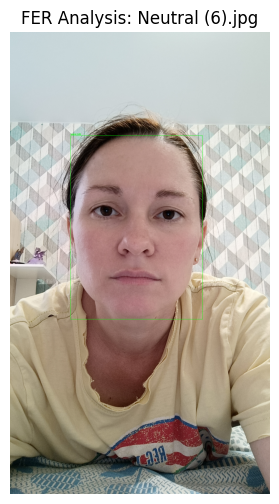

  Analyzed Neutral (7).jpg: Detected 1 face(s), Dominant: neutral (0.730)


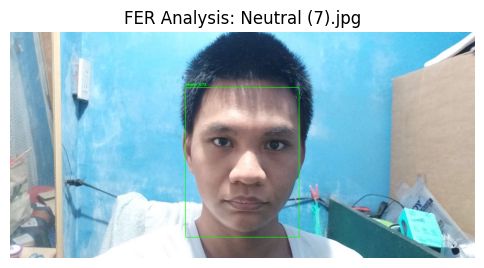

  Analyzed Neutral (8).jpg: Detected 1 face(s), Dominant: neutral (0.930)


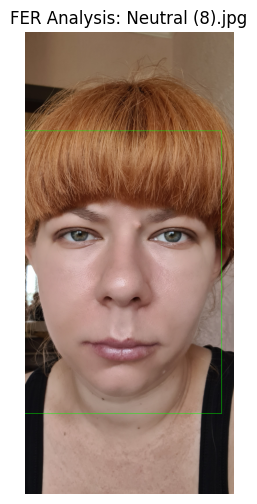

  Analyzed Neutral (9).jpg: Detected 1 face(s), Dominant: neutral (0.670)


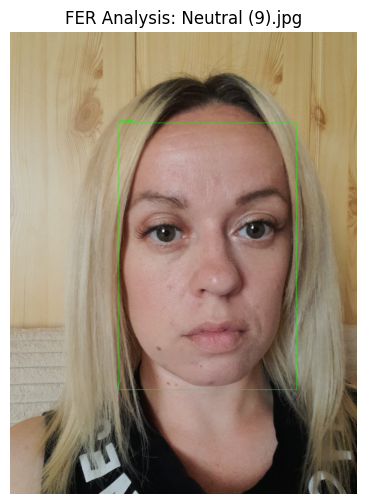


📊 FER Analysis Summary ('happy' class):
             Image  Detected Face Count Dominant Emotion  Dominant Score  \
0      Neutral.jpg                    1          neutral            0.77   
1  Neutral (1).jpg                    1          neutral            0.77   
2  Neutral (2).jpg                    1          neutral            0.52   
3  Neutral (3).jpg                    1          neutral            0.72   
4  Neutral (4).jpg                    1          neutral            0.90   
5  Neutral (5).jpg                    1          neutral            0.59   
6  Neutral (6).jpg                    1          neutral            0.64   
7  Neutral (7).jpg                    1          neutral            0.73   
8  Neutral (8).jpg                    1          neutral            0.93   
9  Neutral (9).jpg                    1          neutral            0.67   

                                        All Emotions  
0  {'angry': 0.11, 'disgust': 0.0, 'fear': 0.04, ...  
1  {'angry':

In [38]:
# prompt: Use FER in a sentimental analisys of the pictures in Happy class

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'Neutral')

# Initialize the FER detector
detector = FER(mtcnn=True) # Use MTCNN for face detection (more robust)

print("\nPerforming FER analysis on 'happy' class images:")

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if image_files:
        fer_results = []
        for image_file in image_files:
            image_path = os.path.join(happy_images_dir, image_file)

            try:
                # Read the image
                img = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # FER expects RGB

                # Detect emotions
                # The detect_emotions() method returns a list of dictionaries,
                # one for each face detected. Each dictionary contains bounding box
                # and emotion scores.
                results = detector.detect_emotions(img_rgb)

                if results:
                    # Assuming one face per image for simplicity, take the first result
                    face_result = results[0]
                    emotions_scores = face_result['emotions']

                    # Get the dominant emotion
                    dominant_emotion = max(emotions_scores, key=emotions_scores.get)
                    dominant_score = emotions_scores[dominant_emotion]

                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': len(results),
                        'Dominant Emotion': dominant_emotion,
                        'Dominant Score': round(dominant_score, 3),
                        'All Emotions': emotions_scores
                    })
                    print(f"  Analyzed {image_file}: Detected {len(results)} face(s), Dominant: {dominant_emotion} ({dominant_score:.3f})")

                    # Optional: Draw bounding box and emotion on the image
                    bbox = face_result['box']
                    x, y, w, h = bbox
                    cv2.rectangle(img_rgb, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    # Put text for dominant emotion and score
                    text = f"{dominant_emotion}: {dominant_score:.2f}"
                    cv2.putText(img_rgb, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

                    plt.figure(figsize=(6, 6))
                    plt.imshow(img_rgb)
                    plt.title(f"FER Analysis: {image_file}")
                    plt.axis('off')
                    plt.show()


                else:
                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': 0,
                        'Dominant Emotion': 'none',
                        'Dominant Score': 0.0,
                        'All Emotions': {}
                    })
                    print(f"  Analyzed {image_file}: No face detected.")

            except Exception as e:
                print(f"  Error processing {image_file}: {e}")
                fer_results.append({
                    'Image': image_file,
                    'Detected Face Count': 'Error',
                    'Dominant Emotion': 'Error',
                    'Dominant Score': 'Error',
                    'All Emotions': 'Error'
                })

        # Display summary table
        print("\n📊 FER Analysis Summary ('happy' class):")
        df_fer = pd.DataFrame(fer_results)
        print(df_fer)

    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")



Performing FER analysis on 'happy' class images:
  Analyzed 0x0.jpg: Detected 1 face(s), Dominant: fear (0.530)


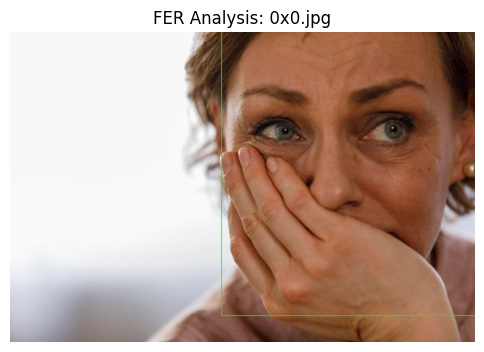

  Analyzed 5acf9ed1146e711e008b46d7.jpg: Detected 1 face(s), Dominant: fear (0.320)


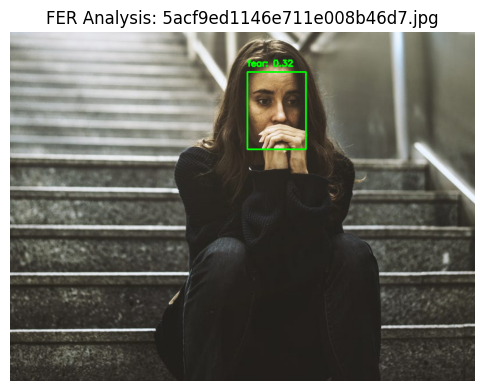

  Analyzed 405-4050267_sad-people-png-sad-person-transparent-background-png.png: No face detected.
  Analyzed 640px-Crying-girl.jpg: Detected 1 face(s), Dominant: sad (0.940)


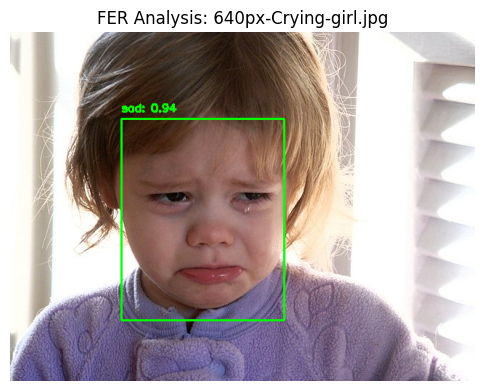

  Analyzed 766x415_Depression_vs_Sadness-1-732x415.jpg: Detected 1 face(s), Dominant: sad (0.420)


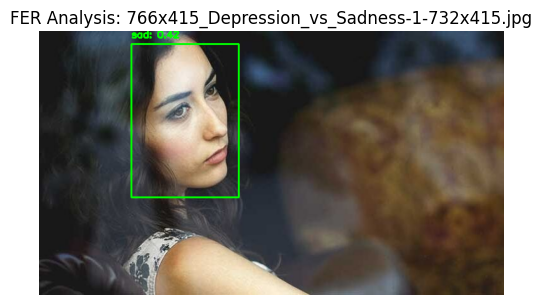

  Analyzed 20201112-Alexithymia-844.jpg: Detected 1 face(s), Dominant: neutral (0.490)


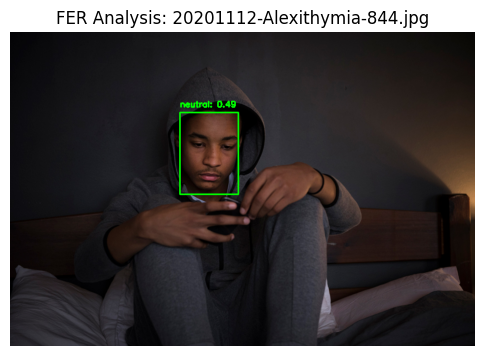

  Analyzed 39843138-sad-man.jpg: Detected 1 face(s), Dominant: neutral (0.510)


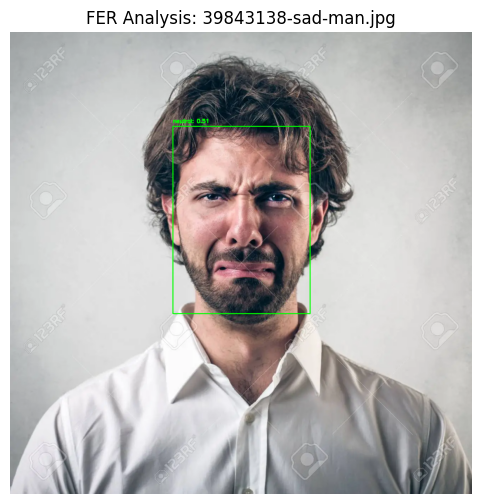

  Analyzed african-american-depressive-sad-broken-260nw-475790911.jpg: Detected 1 face(s), Dominant: neutral (0.460)


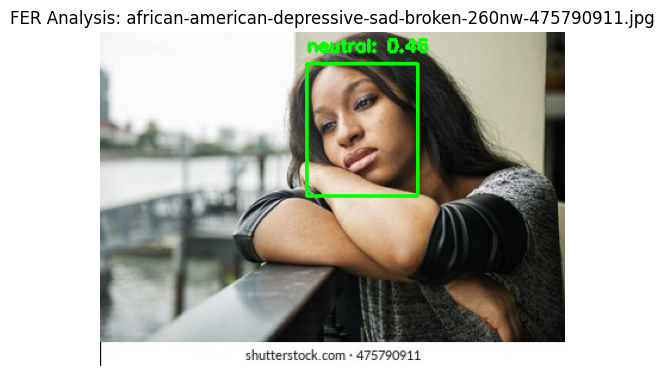

  Analyzed depositphotos_11207956-stock-photo-thoughtful-man-in-the-living.jpg: Detected 1 face(s), Dominant: fear (0.530)


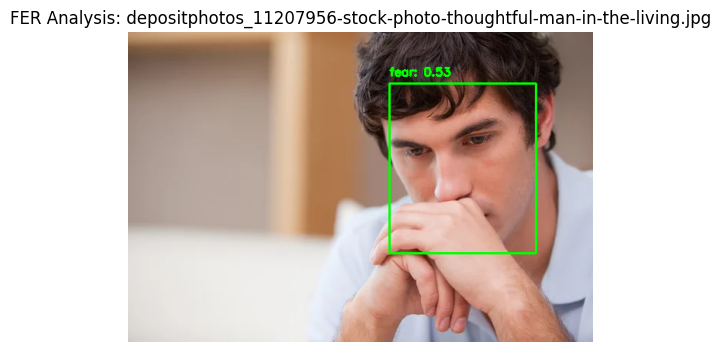

  Analyzed depositphotos_86851530-stock-photo-close-up-of-african-young.jpg: Detected 1 face(s), Dominant: fear (0.510)


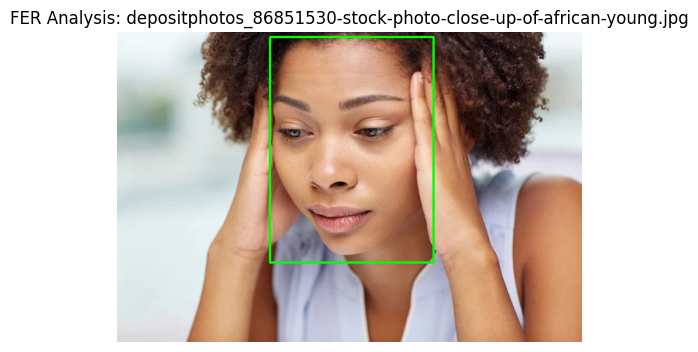


📊 FER Analysis Summary ('happy' class):
                                               Image  Detected Face Count  \
0                                            0x0.jpg                    1   
1                       5acf9ed1146e711e008b46d7.jpg                    1   
2  405-4050267_sad-people-png-sad-person-transpar...                    0   
3                              640px-Crying-girl.jpg                    1   
4        766x415_Depression_vs_Sadness-1-732x415.jpg                    1   
5                       20201112-Alexithymia-844.jpg                    1   
6                               39843138-sad-man.jpg                    1   
7  african-american-depressive-sad-broken-260nw-4...                    1   
8  depositphotos_11207956-stock-photo-thoughtful-...                    1   
9  depositphotos_86851530-stock-photo-close-up-of...                    1   

  Dominant Emotion  Dominant Score  \
0             fear            0.53   
1             fear            0.32 

In [39]:
# prompt: Use FER in a sentimental analisys of the pictures in Happy class

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'Sad')

# Initialize the FER detector
detector = FER(mtcnn=True) # Use MTCNN for face detection (more robust)

print("\nPerforming FER analysis on 'happy' class images:")

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if image_files:
        fer_results = []
        for image_file in image_files:
            image_path = os.path.join(happy_images_dir, image_file)

            try:
                # Read the image
                img = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # FER expects RGB

                # Detect emotions
                # The detect_emotions() method returns a list of dictionaries,
                # one for each face detected. Each dictionary contains bounding box
                # and emotion scores.
                results = detector.detect_emotions(img_rgb)

                if results:
                    # Assuming one face per image for simplicity, take the first result
                    face_result = results[0]
                    emotions_scores = face_result['emotions']

                    # Get the dominant emotion
                    dominant_emotion = max(emotions_scores, key=emotions_scores.get)
                    dominant_score = emotions_scores[dominant_emotion]

                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': len(results),
                        'Dominant Emotion': dominant_emotion,
                        'Dominant Score': round(dominant_score, 3),
                        'All Emotions': emotions_scores
                    })
                    print(f"  Analyzed {image_file}: Detected {len(results)} face(s), Dominant: {dominant_emotion} ({dominant_score:.3f})")

                    # Optional: Draw bounding box and emotion on the image
                    bbox = face_result['box']
                    x, y, w, h = bbox
                    cv2.rectangle(img_rgb, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    # Put text for dominant emotion and score
                    text = f"{dominant_emotion}: {dominant_score:.2f}"
                    cv2.putText(img_rgb, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

                    plt.figure(figsize=(6, 6))
                    plt.imshow(img_rgb)
                    plt.title(f"FER Analysis: {image_file}")
                    plt.axis('off')
                    plt.show()


                else:
                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': 0,
                        'Dominant Emotion': 'none',
                        'Dominant Score': 0.0,
                        'All Emotions': {}
                    })
                    print(f"  Analyzed {image_file}: No face detected.")

            except Exception as e:
                print(f"  Error processing {image_file}: {e}")
                fer_results.append({
                    'Image': image_file,
                    'Detected Face Count': 'Error',
                    'Dominant Emotion': 'Error',
                    'Dominant Score': 'Error',
                    'All Emotions': 'Error'
                })

        # Display summary table
        print("\n📊 FER Analysis Summary ('happy' class):")
        df_fer = pd.DataFrame(fer_results)
        print(df_fer)

    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")



Performing FER analysis on 'happy' class images:
  Analyzed Surprised.jpg: Detected 1 face(s), Dominant: neutral (0.320)


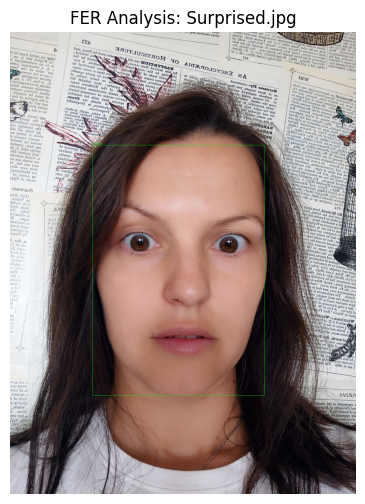

  Analyzed Surprised (1).jpg: Detected 1 face(s), Dominant: neutral (0.790)


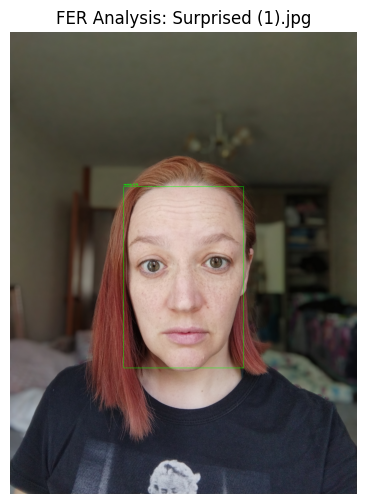

  Analyzed Surprised (2).jpg: Detected 1 face(s), Dominant: fear (0.520)


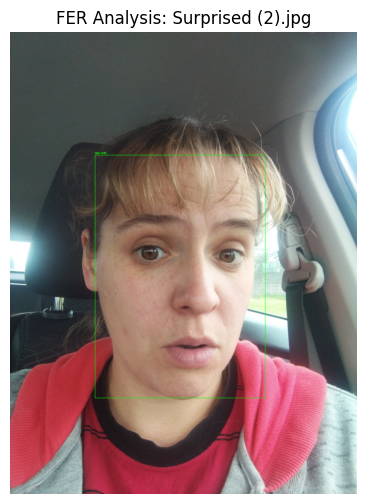

  Analyzed Surprised (3).jpg: Detected 1 face(s), Dominant: neutral (0.540)


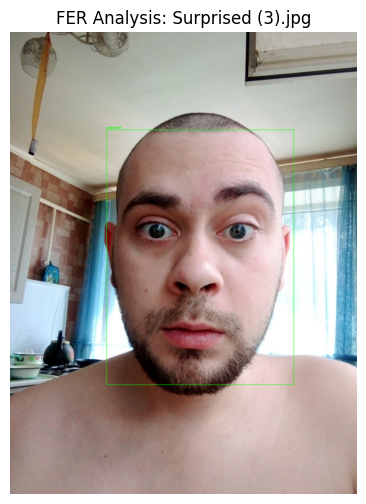

  Analyzed Surprised (4).jpg: Detected 1 face(s), Dominant: neutral (0.540)


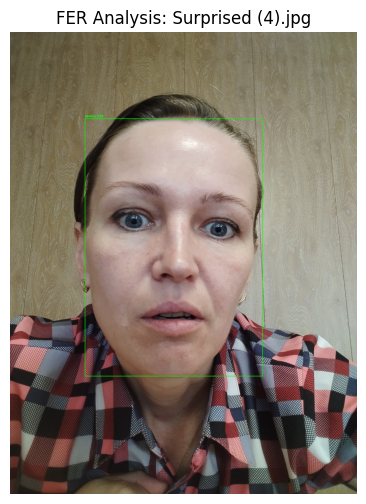

  Analyzed Surprised (5).jpg: Detected 1 face(s), Dominant: angry (0.540)


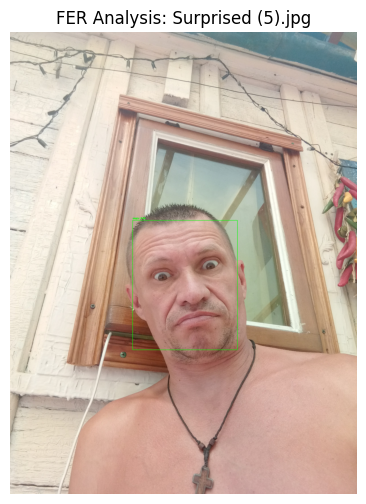

  Analyzed Surprised (6).jpg: Detected 2 face(s), Dominant: sad (0.420)


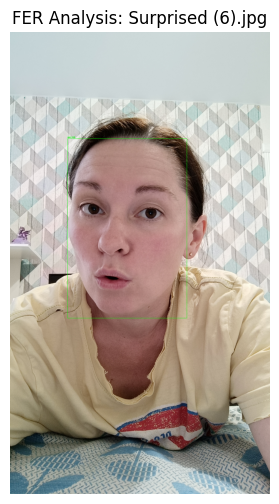

  Analyzed Surprised (7).jpg: Detected 1 face(s), Dominant: surprise (0.810)


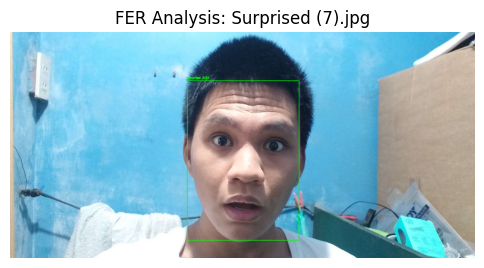

  Analyzed Surprised (8).jpg: Detected 1 face(s), Dominant: neutral (0.600)


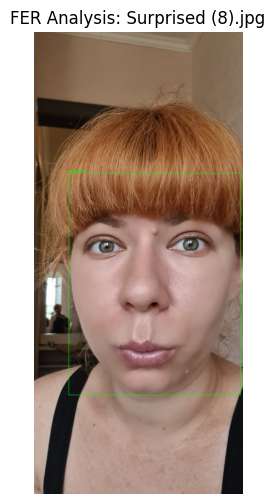

  Analyzed Surprised (9).jpg: Detected 1 face(s), Dominant: surprise (0.970)


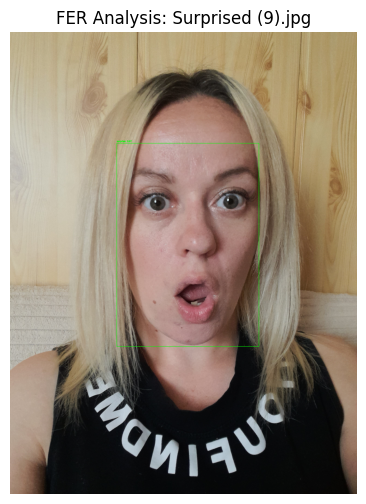


📊 FER Analysis Summary ('happy' class):
               Image  Detected Face Count Dominant Emotion  Dominant Score  \
0      Surprised.jpg                    1          neutral            0.32   
1  Surprised (1).jpg                    1          neutral            0.79   
2  Surprised (2).jpg                    1             fear            0.52   
3  Surprised (3).jpg                    1          neutral            0.54   
4  Surprised (4).jpg                    1          neutral            0.54   
5  Surprised (5).jpg                    1            angry            0.54   
6  Surprised (6).jpg                    2              sad            0.42   
7  Surprised (7).jpg                    1         surprise            0.81   
8  Surprised (8).jpg                    1          neutral            0.60   
9  Surprised (9).jpg                    1         surprise            0.97   

                                        All Emotions  
0  {'angry': 0.14, 'disgust': 0.0, 'fear': 0.

In [40]:
# prompt: Use FER in a sentimental analisys of the pictures in Happy class

# Path to the happy images directory
happy_images_dir = os.path.join(data_dir, 'Suprised')

# Initialize the FER detector
detector = FER(mtcnn=True) # Use MTCNN for face detection (more robust)

print("\nPerforming FER analysis on 'happy' class images:")

# Get list of image files in the 'happy' directory
if os.path.exists(happy_images_dir):
    image_files = [f for f in os.listdir(happy_images_dir) if os.path.isfile(os.path.join(happy_images_dir, f)) and f.lower().endswith(('.png', '.jpg', '.jpeg'))]

    if image_files:
        fer_results = []
        for image_file in image_files:
            image_path = os.path.join(happy_images_dir, image_file)

            try:
                # Read the image
                img = cv2.imread(image_path)
                img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # FER expects RGB

                # Detect emotions
                # The detect_emotions() method returns a list of dictionaries,
                # one for each face detected. Each dictionary contains bounding box
                # and emotion scores.
                results = detector.detect_emotions(img_rgb)

                if results:
                    # Assuming one face per image for simplicity, take the first result
                    face_result = results[0]
                    emotions_scores = face_result['emotions']

                    # Get the dominant emotion
                    dominant_emotion = max(emotions_scores, key=emotions_scores.get)
                    dominant_score = emotions_scores[dominant_emotion]

                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': len(results),
                        'Dominant Emotion': dominant_emotion,
                        'Dominant Score': round(dominant_score, 3),
                        'All Emotions': emotions_scores
                    })
                    print(f"  Analyzed {image_file}: Detected {len(results)} face(s), Dominant: {dominant_emotion} ({dominant_score:.3f})")

                    # Optional: Draw bounding box and emotion on the image
                    bbox = face_result['box']
                    x, y, w, h = bbox
                    cv2.rectangle(img_rgb, (x, y), (x + w, y + h), (0, 255, 0), 2)
                    # Put text for dominant emotion and score
                    text = f"{dominant_emotion}: {dominant_score:.2f}"
                    cv2.putText(img_rgb, text, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

                    plt.figure(figsize=(6, 6))
                    plt.imshow(img_rgb)
                    plt.title(f"FER Analysis: {image_file}")
                    plt.axis('off')
                    plt.show()


                else:
                    fer_results.append({
                        'Image': image_file,
                        'Detected Face Count': 0,
                        'Dominant Emotion': 'none',
                        'Dominant Score': 0.0,
                        'All Emotions': {}
                    })
                    print(f"  Analyzed {image_file}: No face detected.")

            except Exception as e:
                print(f"  Error processing {image_file}: {e}")
                fer_results.append({
                    'Image': image_file,
                    'Detected Face Count': 'Error',
                    'Dominant Emotion': 'Error',
                    'Dominant Score': 'Error',
                    'All Emotions': 'Error'
                })

        # Display summary table
        print("\n📊 FER Analysis Summary ('happy' class):")
        df_fer = pd.DataFrame(fer_results)
        print(df_fer)

    else:
        print(f"No image files found in the '{happy_images_dir}' directory.")
else:
    print(f"Directory not found: {happy_images_dir}")


## 3. Prepare Train/Test Split
Gather all image paths and labels, then split:

In [41]:
# prompt:  Prepare Train/Test Split

from sklearn.model_selection import train_test_split

image_paths = []
labels = []

# Collect all image paths and their corresponding labels
for emo in emotions:
  emo_dir = os.path.join(data_dir, emo)
  if os.path.exists(emo_dir):
    for img_file in os.listdir(emo_dir):
      if img_file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif')):
        image_paths.append(os.path.join(emo_dir, img_file))
        labels.append(emo)
  else:
    print(f"Warning: Directory not found: {emo_dir}. Skipping.")

# Check if any images were found
if not image_paths:
  print("No images found in any of the emotion directories. Please upload images first.")
else:
  # Split the dataset into training and testing sets
  # test_size=0.2 means 20% of the data will be used for testing
  # random_state ensures reproducibility of the split
  # stratify ensures that the proportion of each emotion class is the same in both splits
  X_train, X_test, y_train, y_test = train_test_split(
      image_paths, labels, test_size=0.2, random_state=42, stratify=labels
  )

  print("\nDataset Split Complete:")
  print(f"Total images: {len(image_paths)}")
  print(f"Training images: {len(X_train)}")
  print(f"Testing images: {len(X_test)}")

  # Optional: Print counts per class in train/test sets
  print("\nTraining set class distribution:")
  print(pd.Series(y_train).value_counts())
  print("\nTesting set class distribution:")
  print(pd.Series(y_test).value_counts())


Dataset Split Complete:
Total images: 50
Training images: 40
Testing images: 10

Training set class distribution:
Angry       8
Neutral     8
Sad         8
Happy       8
Suprised    8
Name: count, dtype: int64

Testing set class distribution:
Happy       2
Suprised    2
Neutral     2
Angry       2
Sad         2
Name: count, dtype: int64


## 4. Save Split Lists
Export file lists and labels to CSV for future use:

In [42]:
# prompt: Save Split Lists

# Create DataFrames for train and test sets
df_train = pd.DataFrame({'image_path': X_train, 'label': y_train})
df_test = pd.DataFrame({'image_path': X_test, 'label': y_test})

# Define filenames
train_csv_path = '/content/train_split.csv'
test_csv_path = '/content/test_split.csv'

# Save to CSV files
df_train.to_csv(train_csv_path, index=False)
df_test.to_csv(test_csv_path, index=False)

print(f"\nTraining split saved to: {train_csv_path}")
print(f"Testing split saved to: {test_csv_path}")

# Optional: Display the first few rows of the saved CSVs
print("\nFirst 5 rows of train_split.csv:")
!head -n 6 {train_csv_path}

print("\nFirst 5 rows of test_split.csv:")
!head -n 6 {test_csv_path}


Training split saved to: /content/train_split.csv
Testing split saved to: /content/test_split.csv

First 5 rows of train_split.csv:
image_path,label
/content/drive/MyDrive/Computer Vision/LAB1/Angry/anger-can-kill-you-main.jpg,Angry
/content/drive/MyDrive/Computer Vision/LAB1/Neutral/Neutral (5).jpg,Neutral
/content/drive/MyDrive/Computer Vision/LAB1/Sad/depositphotos_11207956-stock-photo-thoughtful-man-in-the-living.jpg,Sad
/content/drive/MyDrive/Computer Vision/LAB1/Happy/Happy-people-800x533.jpg,Happy
/content/drive/MyDrive/Computer Vision/LAB1/Suprised/Surprised (1).jpg,Suprised

First 5 rows of test_split.csv:
image_path,label
/content/drive/MyDrive/Computer Vision/LAB1/Happy/web3-happy-people-outside-smile-sun-nature-eduardo-dutra-620857-unsplash.jpg,Happy
/content/drive/MyDrive/Computer Vision/LAB1/Suprised/Surprised (2).jpg,Suprised
/content/drive/MyDrive/Computer Vision/LAB1/Neutral/Neutral (1).jpg,Neutral
/content/drive/MyDrive/Computer Vision/LAB1/Angry/anger_ruining_898.jp

Aswer reflection in markdown

1. **Hidden Bias:**  
   Identify one scenario where your current images might lead the model to learn a spurious signal (e.g. background, lighting). How would you test for and eliminate it?

2. **Edge Cases:**  
   Describe a face or expression that your dataset likely fails to capture. What impact could that have on real-world performance, and how would you address it?

3. **Generalization Strategy:**  
   With only 10 images per class, what’s one concrete augmentation or data-collection strategy you’d use to improve robustness—and why that choice?






